In [52]:
import pandas as pd
import matplotlib.pyplot as plt
# !pip install kaleido
home_dir = "/home/e.sharaborin/"
# home_dir = "/Users/weugene/"
a4width = 2480
a4height = 3508
figborderlinesize = 0.7
legborderlinesize = 0.7
pd.options.display.max_columns = None
# !pip install -U plotly orca

In [53]:
import plotly.graph_objects as go
import plotly.express as px
import plotly.io as pio
from pathlib import Path
from math import pi
from scipy.signal.windows import blackman # window function
from scipy.signal.windows import barthann
from scipy.signal.windows import chebwin
from scipy.fftpack import fft, fftfreq, ifft
from numpy.fft import irfft
import plotly
from scipy.optimize import curve_fit
plotly.io.orca.config.executable = '/Applications/orca.app/Contents/MacOS/orca'
plotly.io.orca.config.save()


theta_sym ='\u03B8'
delta_sym = '\u03B4'
Delta_sym = '\u0394'
Sigma_sym = '\u03A3'
omega_sym = '\u03C9'
hat_sym   = '\u0302' #symbol + hat_sym

def plot_graph(list_x_, list_y_, names, xtitle, ytitle, image_name, list_errors=None, add_error_bar=None, mode=['lines+markers']*20,
               xrange=[], yrange=[],
               dash=['solid', 'dot', 'dash', 'longdash'],
               colors=['blue', 'red', 'hsv(120,100,100)', 'green', 'black' ],
               marker_size=15, line_size=3,
               marker_style = ['circle' ]*20, #'triangle-up', 'triangle-down','square', 'diamond', 'cross',  'x-thin', 'cross-thin' 
               width=1000, height=500, path='./', xlog=False, ylog=False, 
               yanchor='top', y0_anchor=0.99, xanchor='right', x0_anchor=0.99, legend_orientation=None, showlegend=True,
               legborderlinesize=0.7, figborderlinesize=0.7, lmargin=0, rmargin=0, bmargin=0, tmargin=0, padmargin=0.1, debug=False,
               legendfont_size=18, tickfont_size=18, titlefont_size=20):

    list_x, list_y = [], []
    for i,x in enumerate(list_x_):
        y = list_y_[i]
        list_x.append(np.array(x))
        list_y.append(np.array(y))
    if mode == []:
        for i in range(len(list_x)):
            mode.append('lines+markers')
    if xrange == []:
        minx, maxx = [], []
        for i,x in enumerate(list_x):
            minx.append(x.min())
            maxx.append(x.max())
        xrange = [minx, maxx]
    if yrange == []:
        miny, maxy = [], []
        for i,y in enumerate(list_y):
            miny.append(y.min())
            maxy.append(y.max())
        yrange = [miny, maxy]

    axis_style = dict(showline=True, 
                  gridwidth=1, 
                  gridcolor='lightgrey', 
                  linewidth=2, 
                  linecolor='black', 
                  mirror=True, 
                  ticks='outside',
                  tickfont = dict(family = 'Times New Roman', 
                                  size = tickfont_size, 
                                  color = 'black'),
                  titlefont = dict(family = 'Times New Roman',
                                   size = titlefont_size,
                                   color = 'black'
              ))
    
    bg_style = {'plot_bgcolor': 'rgba(255, 255, 255, 1)', 'paper_bgcolor': 'rgba(255, 255, 255, 1)',}


    fig = go.Figure()
    for i,x in enumerate(list_x):
        if debug:
            print('curve number',i)        
        y = list_y[i]
        if list_errors!=None and add_error_bar[i]:
            fig.add_trace(go.Scatter(x=x, y=y, name=names[i],
                     error_y=dict(
                         type='data', # value of error bar given in data coordinates
                         array=list_errors[i],
                         visible=True),
                     mode=mode[i],
                     marker=dict(
                         size=marker_size,
                         line=dict(
                             color=colors[i],
                             width=1
                         )
                     ),
                     marker_symbol=marker_style[i],
                     line=dict(color=colors[i], width=line_size, dash=dash[i])))
        else:
            fig.add_trace(go.Scatter(x=x, y=y, name=names[i],
                     mode=mode[i],
                     marker=dict(
                         size=marker_size,
                         line=dict(
                             color=colors[i],
                             width=1
                         )
                     ),
                     marker_symbol=marker_style[i],
                     line=dict(color=colors[i], width=line_size, dash=dash[i])))
    fig.update_layout(
        width = width,
        height = height,
        xaxis_title=xtitle,
        yaxis_title=ytitle,
        showlegend=showlegend
    )
    fig.update_layout(bg_style)
    fig.update_xaxes(axis_style)
    fig.update_yaxes(axis_style)
    fig.update_layout(legend=dict(
        # yanchor="bottom",
        # y=0.1,
        # xanchor="left",
        # x=1.01,
        bgcolor="White",
        bordercolor="Black",
        borderwidth=figborderlinesize
    ))
    fig.update_layout(
        
        autosize=False,
        margin=dict(
            l=lmargin,
            r=rmargin,
            b=bmargin,
            t=tmargin,
            pad=padmargin
        ),
        #     paper_bgcolor="LightSteelBlue",
    )
    fig.update_yaxes(side='left',tickangle=0,automargin=True)
    fig.update_xaxes(side='bottom',tickangle=0,automargin=True)


    fig.update_layout(
        legend=dict(
        yanchor=yanchor,
        y=y0_anchor,
        xanchor=xanchor,
        x=x0_anchor,
            borderwidth=legborderlinesize
    ))
    fig.update_layout(
        font=dict(
            family="Times New Roman",
            size=legendfont_size
        )
    )
    if legend_orientation is not None:
        fig.update_layout(legend_orientation=legend_orientation)

    if xlog:
        fig.update_xaxes(type="log")
    if ylog:
        fig.update_yaxes(type="log")
    fig.update_xaxes(range=xrange)
    fig.update_yaxes(range=yrange)
    fig.show()
    fn = path + image_name
    pio.write_image(fig, str(Path(fn)))#, engine='kaleido'
    print("Successfully generated:", fn)





import itertools
import operator
from scipy.interpolate import interp1d

def monotone_increasing(lst):
    pairs = zip(lst, lst[1:])
    return all(itertools.starmap(operator.lt, pairs))

# def mean_value(x, y, tavg):
#     nan_num = np.isnan(x) + np.isnan(y)
#     if nan_num.sum() > 0:
#         print("Alert! there is nan in x, y array")
#         x = x[~nan_num]
#         y = y[~nan_num]
#     nan_num = np.isnan(x) + np.isnan(y)
#     if nan_num.sum() == 0:
#         print('Array is cleaned of Nan')

#     if tavg:
#         pass
#     else:
#         tavg = [np.min(x), np.max(x)]
#         print('tavg', tavg)
        
#     try:
#         sel = (x >= tavg[0]) & (x <= tavg[1])
#         xs = x[sel]
#         ys = y[sel]
#         T = xs.max() - xs.min()
#         print('T mean=', T)
#         ss = np.trapz(y=ys, x=xs)
#         f_mean = ss/T
#         print('ss=', ss, 'fmean=', f_mean)
#         return f_mean
#     except:
#         T = x.max() - x.min()
#         print('T mean=', T)
#         ss = np.trapz(y=y, x=x)
#         f_mean = ss/T
        
            
#         print('ss=', ss, 'fmean=', f_mean)
#         return f_mean

def mean_value(x, y, tavg=None, frac=0.8):
    nan_num = np.isnan(x) + np.isnan(y)
    if nan_num.sum() > 0:
        print("Alert! there is nan in x, y array")
        x = x[~nan_num]
        y = y[~nan_num]
    try:
        NT = int(frac*x.shape[0])
    except:
        NT = int(frac*len(x))
#     print('NT=', NT)
    x = x[NT:]
    y = y[NT:]

    if NT <2:
        print("NT too short")
        return None

    if tavg == None and frac == None:
        tavg = [np.min(x), np.max(x)]

    try:
        sel = (x >= tavg[0]) & (x <= tavg[1])
        xs = x[sel]
        ys = y[sel]
        T = xs.max() - xs.min()
        ss = np.trapz(y=ys, x=xs)
        f_mean = ss/T
        # Std calculation
        f_std = np.std(ys)
        print('tavg used: T mean=', T, 'ss=', ss, 'fmean=', f_mean)
        return [xs.min(), xs.max()], [f_mean, f_mean], f_std
    except:
        T = x.max() - x.min()
        ss = np.trapz(y=y, x=x)
        f_mean = ss/T    
        # Std calculation
        f_std = np.std(y)
        print('T mean=', T, 'ss=', ss, 'fmean=', f_mean)
        return [x.min(), x.max()], [f_mean, f_mean], f_std
    
def myfft(t_full, f_full, window=None, freqcut=None, num_output=False, filter_fun=None, Ntop=5):
    t = np.array(t_full)
    f = np.array(f_full)
    
    # Apply a window t,f array 
    if window != None and len(window) == 2:
        print("fourier window")
        ind = (t > window[0]) & (t < window[1])
        t = t[ind]
        f = f[ind]
        
    # Sample duration
    T = t[-1] - t[0]
    # Number of sample points
    N = t.shape[0]
    
    # Interpolate to uniform mesh
    fun = interp1d(t, f, kind='cubic')
    N = 10*N
    N_half = np.int(np.ceil(0.5*N))
    timestep = T/(N - 1)
    tr = np.linspace(t[0], t[-1], N)
    fr = fun(tr)
    
    # Choose a filter
    if filter_fun == None:
        w = np.ones(N)
    else:
        w = filter_fun(N)
    # Apply a filter to the signal
    fr *= w
    
    # Mean substraction
    dt = tr[1] - tr[0]
    ss = np.trapz(y=fr, x=tr)
    f_mean = ss/T
    fr -= f_mean
    
    print('f_mean=', f_mean, '1/(d*N)=', 1/(dt*N), 'handle freq=', (0.5/dt), 'N=', N)
    
    freq = 2*np.pi*fftfreq(N, dt) 
    if freqcut == None: # do not cut
        freqcut = [0, np.max(freq)]
    freq_num = np.arange(N_half)
    
    # FFT and power calculation
    sp = fft(fr)
    res = np.absolute(sp)**2
    freq = np.asarray(freq)
    
    # Calculation of threshold
    mask_threshold = (freq > freqcut[0]) & (freq < freqcut[1])
    res_cut = np.where(mask_threshold, res, 0)
    P_max = max(res_cut)
    sorted_ampl = sorted(res_cut)
    
    threshold = max(sorted_ampl[-Ntop], 0.2*P_max)
    mask_threshold = (res_cut >= threshold)
    print('the Nth big freq = ', freq[mask_threshold], ' P=', res[mask_threshold], 'threshold:', threshold)
    # Compressed data
    mask = (np.abs(freq) > freqcut[0]) & (np.abs(freq) < freqcut[1])
    sp_compressed = np.where(mask, sp, 0)
    
    fig = go.Figure()
    fig.add_trace(go.Scatter(x=freq, y=res))
    fig.add_trace(go.Scatter(x=[freqcut[0], freqcut[0]], y=[0, max(res)]))
    fig.update_xaxes(range=[0,freqcut[1]])
    fig.show()
    
    Fmax = max(f_full)
    fig = go.Figure()
    fig.add_trace(go.Scatter(x=t_full, y=f_full, name='original data'))
    fig.add_trace(go.Scatter(x=tr, y=fr, name='preprocessed data'))
    fig.add_trace(go.Scatter(x=tr, y=ifft(sp).real, name='Fourier data'))
    fig.add_trace(go.Scatter(x=tr, y=ifft(sp_compressed).real, name='Fourier compressed data'))
    fig.add_trace(go.Scatter(x=[t[0], t[0]], y=[0, Fmax]))
    fig.add_trace(go.Scatter(x=[t[-1], t[-1]], y=[0, Fmax]))
    fig.show()
    
#     plt.figure(figsize=(20,10))
#     plt.plot(t_full, f_full, 'b-', label='original data')
#     plt.plot(tr, fr, 'r.', label='preprocessed data')
#     plt.plot(tr, ifft(sp), 'g-', label='Fourier data')
#     plt.plot(tr, ifft(sp_compressed), 'k-', label='Fourier compressed data')
#     plt.legend()
#     plt.xlim([0,max(t_full)])
#     plt.show()
    
    freq, res = zip(*sorted(zip(freq, res)))
    freq = np.asarray(freq)
    mask = (np.abs(freq) > freqcut[0]) & (np.abs(freq) < freqcut[1])
    res = np.asarray(res)
    res = np.where(mask, res, 0)
    res = res/np.max(res)
    if num_output:
        return freq_num, res
    else:
        return freq, res
    
mode_lines_all=['lines']*20
mode_lines_and_markers_all=['lines+markers']*20
ttitle = '$\Large t, \mathrm{ms}$'
omegatitle=r"$\Large\omega, \quad s^{-1}$"
Ptitle=r"$\Large P(\delta_{\min})/P_{\max}$"

# Reading 'delta_u_mean_stats.xlsx' file

In [54]:
import pandas as pd
import numpy as np
import plotly.graph_objects as go
import plotly.express as px
from plotly.offline import iplot, init_notebook_mode
import plotly.io as pio
import glob, os, sys
import logging
from sys import argv
import re
import csv
from scipy.signal import find_peaks
from pathlib import Path
from tsmoothie.smoother import DecomposeSmoother

# pio.orca.config.executable = str(Path('C:/Users/Weugene/AppData/Local/Programs/orca/orca.exe'))
np.set_printoptions(threshold=sys.maxsize)
import scipy.spatial.distance as ds

#########################################################
### Draw delta_mean over time

names_exp = ["Experiments (Khodaparast et al. 2015)", "Fluent (Khodaparast et al. 2015)", "OpenFOAM (Khodaparast et al. 2015)"]
subname = ['<sub>* mean</sub>[-]', '<sub>* min</sub>[-]', '<sub>* max</sub>[-]']
subname_files = ['_mean', '_min', '_max']

case_names = {'18':'AW1','19':'AW2', '20':'AW3', '21':'AW4', '22':'AW5', '23':'AW6', '24':'AW7', '25':'AW8'}
case_color = {'18':'blue', '19':'red', '20':'hsv(120,100,100)', '21':'green', '22':'black', '23': 'orange', '24':'yellow', '25':'pink'} 
case_line = {'min': 'solid', 'mean': 'dash', 'max':'dotted'}
vel_norm = {'18': 0.242, '19': 0.666, '20': 0.757, '21': 1.118, '22': 1.580, '23': 2.060, '24': 2.575, '25': 3.09}
diam = 0.514e-3; # the diameter of the channel
Mu1 = 0.88e-3;
Sigma = 72.8e-3;

# rpath = '/home/e.sharaborin/basilisk/work/tube/'
rpath = '/Users/weugene/basilisk/work/tube/'

tab = pd.read_excel(rpath + '/delta_u_mean_stats.xlsx', sheet_name=None, header=0)
sheets = tab.keys()
# thickness for experimental results
delta_min_exp = []
delta_mean_exp = []
delta_max_exp = []


# mean of delta by time
tavg = {}
time_max = 0
for j,case in enumerate(sheets):
#     print('case=', case)
    try:
        arr_t = tab[case]['t'].values
        arr_t = arr_t[~np.isnan(arr_t)]
        tab[case]['t_nond']= tab[case]['t']
        
        if case == '18':# case a 18 AW1
            tavg[case] = [1.57, max(arr_t)]
        elif case == '19':
            tavg[case] = [0, max(arr_t)]
        elif case == '20':
            tavg[case] = [0, max(arr_t)]
        elif case == '21':
            tavg[case] = [0, max(arr_t)]
        elif case == '22':
            tavg[case] = [10, max(arr_t)]
        else:
            assert(False, 'ERROR. cannot read')
            
        tab[case]['x_peak_rel'] = tab[case]['x_nose'] - tab[case]['x_peak']
        tab[case]['x_mean_rel'] = tab[case]['x_nose'] - tab[case]['x_mean']
        tab[case]['x_tail_rel'] = tab[case]['x_nose'] - tab[case]['x_tail']
        tab[case]['t_ms'] = tab[case]['t']*(diam/vel_norm[case])*1000
        time_max = max(time_max, max(tab[case]['t_ms']))
    except:
        pass

print(time_max)
tab['24'].head()

26.63819867768589


,t,x_tail,x_peak,y_peak,x_mean,x_nose,x_nose_ISC,volume,UmeanV,delta_min,delta_mean,delta_max,delta_min_smooth,delta_max_smooth,Ca,Uflow_m_s,U_meanVT,U_meanVT_m_s,delta_minVT,delta_meanVT,delta_maxVT,maxlevel,Ldomain,dx,N_per_delta,t_nond,x_peak_rel,x_mean_rel,x_tail_rel,t_ms
0,0.011428,1.879965,2.295411,0.451471,3.281983,4.701508,?,1.595067,1.233242,0.047003,0.051659,0.061232,0.050154,0.052055,0.045500,2.575,1.46119,3.76256,0.0665265,0.134893,0.293468,13,30,0.003662,36.834674,0.011428,2.406097,1.419525,2.821543,0.002281
1,0.023516,1.902537,2.207198,0.437325,3.296751,4.725461,?,1.596393,1.232970,0.046734,0.051381,0.061179,0.049933,0.051962,0.045482,NaN,0.00107546,0.00276932,0.0133294,0.001642,0.137783,NaN,NaN,NaN,NaN,0.023516,2.518263,1.428710,2.822924,0.004694
2,0.035603,1.928280,2.002431,0.318520,3.310386,4.749396,?,1.600083,1.229512,0.047762,0.050771,0.061225,0.049767,0.051420,NaN,Aver_iter_min,Aver_iter_max,SLOPE,INTERCEPT,NaN,NaN,NaN,NaN,NaN,NaN,0.035603,2.746965,1.439009,2.821116,0.007107
3,0.047691,1.952349,2.002431,0.318520,3.311598,4.775530,?,1.600002,1.231527,0.047726,0.050608,0.061176,0.049599,0.051200,NaN,413,600,1.46047,4.97664,NaN,NaN,NaN,NaN,NaN,NaN,0.047691,2.773099,1.463932,2.823181,0.009520
4,0.059779,1.976504,2.207198,0.437325,3.326502,4.798038,?,1.601151,1.231233,0.047506,0.050464,0.061224,0.049398,0.051314,NaN,t=10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.059779,2.590840,1.471536,2.821534,0.011933


# delta $\delta_*$ min, avg for case AW5 (22)

In [8]:
cases = ['22']
deltas = ['min', 'mean']#, 'max'
list_x, list_y, list_colors, list_names, list_lines = [], [], [], [], []
delta_avg = {'min':{}, 'mean':{}, 'max':{}}

T1_22, T2_22, T3_22 = 5, 13, 16.11

for i,delta_label in enumerate(deltas): 
    for j,case in enumerate(cases):
        x = tab[case]['t'].values
        y = tab[case]['delta_' + delta_label].values
        x = x[~np.isnan(y)]
        y = y[~np.isnan(y)]
        mean_val = mean_value(x, y, tavg[case])
        delta_avg[delta_label][case] = mean_val
        print('mean_val:', mean_val)


for i,delta_label in enumerate(deltas): 
    for j,case in enumerate(cases):
        print('case',case)
        x = tab[case]['t'].values
        y = tab[case]['delta_' + delta_label].values
        list_x.append(x)
        list_y.append(y)
        list_colors.append(case_color[case])
        list_names.append(case_names[case])
        list_lines.append(case_line[delta_label])

if False:
    x = tab['22']['t'].values
    y = tab['22']['delta_min'].values
    tavg1 = [5,13]
    list_x.append(tavg1)        
    mean_val = mean_value(x, y, tavg1) #0.038175481997649
    list_y.append([mean_val, mean_val])

    tavg1 = [16.15,19.07]
    list_x.append(tavg1)        
    mean_val = mean_value(x, y, tavg1) #0.02838631511313361
    list_y.append([mean_val, mean_val])

    x = tab['22']['t'].values
    y = tab['22']['delta_mean'].values
    tavg1 = [5,19.07]
    list_x.append(tavg1)        
    mean_val = mean_value(x, y, tavg1) #0.038175481997649
    list_y.append([mean_val, mean_val])

    # tt = np.linspace(0,19, 1000)
    # list_x.append(tt)
    # list_x.append(tt)
    # list_y.append(0.01*np.sin(2*np.pi*0.15*tt))
    # list_y.append(0.01+ 0.01*np.sin(2*np.pi*1.54*tt))
    # list_name.append('xz=0.618')
    # list_name.append('xz=1.54')
fn = 'delta_{}_{}.pdf'.format("_".join(deltas), "_".join(cases))
plot_graph(list_x, list_y, names=list_names, 
               xtitle='t', ytitle=r"$\Large\hat{\delta}_\text{min}, \hat{\delta}_\text{avg}$", image_name=fn, \
               mode=mode_lines_all,\
               xrange=[0,20], yrange=[0.0,0.09],\
               dash=list_lines,\
               colors=list_colors,\
               width=1000, height=500, path=rpath, legend_orientation='h')

list_x, list_y = [], []
delta_avg = {'min':{}, 'mean':{}, 'max':{}}

# T1_22, T2_22, T3_22 = 5, 13, 16.11

for i,delta_label in enumerate(deltas): 
    for j,case in enumerate(cases):
        x = tab[case]['t_ms'].values
        y = tab[case]['delta_' + delta_label].values
        x = x[~np.isnan(y)]
        y = y[~np.isnan(y)]
        mean_val = mean_value(x, y, tavg[case])
        delta_avg[delta_label][case] = mean_val
        print('mean_val:', mean_val)
        list_x.append(x)
        list_y.append(y)

fn = 'delta_{}_{}_t_ms.pdf'.format("_".join(deltas), "_".join(cases))
plot_graph(list_x, list_y, names=list_names, 
               xtitle='t, ms', ytitle=r"$\Large\hat{\delta}_\text{min}, \hat{\delta}_\text{avg}$", image_name=fn, \
               mode=mode_lines_all,\
               xrange=[0,6.5], yrange=[0.0,0.09],\
               dash=list_lines,\
               colors=list_colors,\
               width=1000, height=500, path=rpath, legend_orientation='h')

tavg used: T mean= 4.2499 ss= 0.11214264637923266 fmean= 0.026387125903958364
mean_val: ([14.9341, 19.184], [0.026387125903958364, 0.026387125903958364], 0.007402250881008376)
tavg used: T mean= 4.2499 ss= 0.3047058635100157 fmean= 0.07169718428904578
mean_val: ([14.9341, 19.184], [0.07169718428904578, 0.07169718428904578], 0.0006688658313756339)
case 22
case 22


Successfully generated: /Users/weugene/basilisk/work/tube/delta_min_mean_22.pdf
T mean= 1.3825624050632905 ss= 0.036481848252484524 fmean= 0.02638712590395836
mean_val: ([4.858308481012659, 6.24087088607595], [0.02638712590395836, 0.02638712590395836], 0.007402250881008376)
T mean= 1.3825624050632905 ss= 0.09912583154692912 fmean= 0.0716971842890458
mean_val: ([4.858308481012659, 6.24087088607595], [0.0716971842890458, 0.0716971842890458], 0.0006688658313756339)


Successfully generated: /Users/weugene/basilisk/work/tube/delta_min_mean_22_t_ms.pdf


# All delta for all cases

In [10]:
cases = ['18',  '20', '21', '22', '23', '24', '25']
deltas = ['min', 'mean']
list_x, list_y, list_colors, list_names, list_lines = [], [], [], [], []
variables = ['delta_min', 'delta_mean']
# names = ['min: AW1', 'AW2', 'AW3', 'AW4', 'AW5', 'mean:AW1', 'AW2', 'AW3', 'AW4', 'AW5']
names = ['min: AW1', 'AW2', 'AW3', 'AW4', 'AW5', 'AW6', 'AW7', 'mean:AW1', 'AW2', 'AW3', 'AW4', 'AW5', 'AW6', 'AW7']
case_names = {'18':'AW1','19':'AW2', '20':'AW3', '21':'AW4', '22':'AW5', '23':'AW6', '24':'AW7', '25':'AW8'}
case_color = {'18':'blue', '19':'red', '20':'hsv(120,100,100)', '21':'green', '22':'black', '23': 'orange', '24':'rgb(214, 39, 40)', '25':'rgb(227, 119, 194)'} 

title = r"$\Large\delta_\text{min}, \delta_\text{avg}$"

for i,delta_label in enumerate(deltas): 
    fig = go.Figure()
#     display(tab[case].head())
    for j,case in enumerate(cases):
        list_x.append(tab[case]['t'].values)
        list_y.append(tab[case]['delta_' + delta_label].values)
        if j == 0:
            list_names.append("{}: {}".format(delta_label, case_names[case]) )
        else:
            list_names.append(case_names[case])
        list_colors.append(case_color[case])
        list_lines.append(case_line[delta_label])

# fn = 'delta_{}_{}.pdf'.format("_".join(deltas), "_".join(cases))
# plot_graph(list_x, list_y, names=list_names, xtitle='t', ytitle=title, image_name=fn, \
#                mode=mode_lines_all,\
#                xrange=[0,20], yrange=[0.0,0.12],\
#                dash=list_lines, line_size=2,\
#                colors=list_colors,\
#                width=1000, height=500, path=rpath,  legend_orientation='h', showlegend=False,
#                yanchor='bottom', y0_anchor=0.83, xanchor='left', x0_anchor=0.07, legborderlinesize=0.1)

list_x, list_y = [], []
for i,delta_label in enumerate(deltas): 
    fig = go.Figure()
#     display(tab[case].head())
    for j,case in enumerate(cases):
        list_x.append(tab[case]['t_ms'].values)
        list_y.append(tab[case]['delta_' + delta_label].values)

fn = 'delta_{}_{}_t_ms.pdf'.format("_".join(deltas), "_".join(cases))
plot_graph(list_x, list_y, names=list_names, xtitle='$\Large t, \mathrm{ms}$', ytitle=title, image_name=fn, \
               mode=mode_lines_all,\
               xrange=[0,6.5], yrange=[0.0,0.08],\
               dash=list_lines, line_size=2,\
               colors=list_colors,\
               width=1000, height=500, path=rpath,  legend_orientation='h', showlegend=False,
           yanchor='bottom', y0_anchor=0.83, xanchor='left', x0_anchor=0.07, legborderlinesize=0.1)


Successfully generated: /Users/weugene/basilisk/work/tube/delta_min_mean_18_20_21_22_23_24_25_t_ms.pdf


# All delta for cases AW1-AW3

In [6]:
cases = ['18', '19', '20']
deltas = ['min', 'mean']
list_x, list_y, list_colors, list_names, list_lines = [], [], [], [], []
variables = ['delta_min', 'delta_mean']
names = ['min:AW1', 'AW2', 'AW3', 'AW4', 'AW5', 'mean:AW1', 'AW2', 'AW3', 'AW4', 'AW5']
title = r"$\Large\hat{\delta}_\text{min},\hat{\delta}_\text{avg}$"

for i,delta_label in enumerate(deltas): 
    fig = go.Figure()
#     display(tab[case].head())
    for j,case in enumerate(cases):
        list_x.append(tab[case]['t'].values)
        list_y.append(tab[case]['delta_' + delta_label].values)
        if j == 0:
            list_names.append("{}:{}".format(delta_label, case_names[case]) )
        else:
            list_names.append(case_names[case])
        list_colors.append(case_color[case])
        list_lines.append(case_line[delta_label])

# plot_graph(list_x, list_y, names=list_names, xtitle='t', ytitle=title, image_name='delta_min_mean_AW1-3.pdf', \
#                mode=mode_lines_all,\
#                xrange=[0,10], yrange=[0.0,0.1],\
#                dash=list_lines,\
#                colors=list_colors,\
#                width=1000, height=500, path=rpath,  legend_orientation='h', yanchor='bottom', y0_anchor=0.83, xanchor='left', x0_anchor=0.14, legborderlinesize=0.1)

list_x, list_y = [], []
for i,delta_label in enumerate(deltas): 
    fig = go.Figure()
#     display(tab[case].head())
    for j,case in enumerate(cases):
        list_x.append(tab[case]['t_ms'].values)
        list_y.append(tab[case]['delta_' + delta_label].values)
        

plot_graph(list_x, list_y, names=list_names, xtitle='t, ms', ytitle=title, image_name='delta_min_mean_AW1-3_t_ms.pdf', \
               mode=mode_lines_all,\
               xrange=[0,6.5], yrange=[0.0,0.1],\
               dash=list_lines,\
               colors=list_colors, showlegend=True,\
               width=1000, height=500, path=rpath,  legend_orientation='h', yanchor='bottom', y0_anchor=0.83, xanchor='left', x0_anchor=0.14, legborderlinesize=0.1)


Successfully generated: /Users/weugene/basilisk/work/tube/delta_min_mean_AW1-3_t_ms.pdf


# All delta for cases AW4-AW5

In [7]:
cases = [ '20', '21', '22']
deltas = ['min', 'mean']
list_x, list_y, list_colors, list_names, list_lines = [], [], [], [], []
variables = ['delta_min', 'delta_mean']
names = ['min:AW1', 'AW2', 'AW3', 'AW4', 'AW5', 'mean:AW1', 'AW2', 'AW3', 'AW4', 'AW5']
title = r"$\Large\hat{\delta}$"

for i,delta_label in enumerate(deltas): 
    fig = go.Figure()
#     display(tab[case].head())
    for j,case in enumerate(cases):
        list_x.append(tab[case]['t'].values)
        list_y.append(tab[case]['delta_' + delta_label].values)
        if j == 0:
            list_names.append("{}:{}".format(delta_label, case_names[case]) )
        else:
            list_names.append(case_names[case])
        list_colors.append(case_color[case])
        list_lines.append(case_line[delta_label])

# plot_graph(list_x, list_y, names=list_names, xtitle='t', ytitle=title, image_name='delta_min_mean_AW4-5.pdf', \
#                mode=mode_lines_all,\
#                xrange=[0,20], yrange=[0.0,0.1],\
#                dash=list_lines,\
#                colors=list_colors,\
#                width=1000, height=500, path=rpath,  legend_orientation='h', yanchor='bottom', y0_anchor=0.83, xanchor='left', x0_anchor=0.14, legborderlinesize=0.1)

list_x, list_y = [], []
for i,delta_label in enumerate(deltas): 
    fig = go.Figure()
#     display(tab[case].head())
    for j,case in enumerate(cases):
        list_x.append(tab[case]['t_ms'].values)
        list_y.append(tab[case]['delta_' + delta_label].values)

plot_graph(list_x, list_y, names=list_names, xtitle='t, ms', ytitle=title, image_name='delta_min_mean_AW3-5_t_ms.pdf', \
               mode=mode_lines_all,\
               xrange=[0,6.5], yrange=[0.0,0.1],\
               dash=list_lines,\
               colors=list_colors,\
               width=1000, height=500, path=rpath,  legend_orientation='h', yanchor='bottom', y0_anchor=0.83, xanchor='left', x0_anchor=0.14, legborderlinesize=0.1)


Successfully generated: /Users/weugene/basilisk/work/tube/delta_min_mean_AW3-5_t_ms.pdf


# Minimum thickness over time for all case

In [8]:
cases = ['18', '19', '20', '21', '22', '23', '24', '25']
deltas = ['min']
list_x, list_y, list_colors, list_names, list_lines = [], [], [], [], []

variables = ['delta_min']
title = r"$\Large\hat{\delta}_{\min}$"

for i,delta_label in enumerate(deltas): 
    fig = go.Figure()
    for j,case in enumerate(cases):
        list_x.append(tab[case]['t'].values)
        list_y.append(tab[case]['delta_' + delta_label].values)
        list_colors.append(case_color[case])
        list_names.append(case_names[case])
        list_lines.append(case_line[delta_label])
#test

# list_x.append(tab[case]['t'].values)
# list_y.append(0.07+ 0.002*np.sin(8.48*list_x[-1]))
        
# plot_graph(list_x, list_y, names=list_names, xtitle='t', ytitle=title, image_name='delta_min_all_case.pdf', \
#                mode=mode_lines_all, yrange=[-0.01,0.075],\
#                dash=list_lines,\
#                colors=list_colors,\
#                marker_size=3, line_size=2,\
#                marker_style = ['circle', 'triangle-up', 'triangle-down','square', 'diamond', 'cross',  'x-thin', 'cross-thin' ],\
#                width=700, height=500, path=rpath,
#                legend_orientation='h', yanchor='bottom', y0_anchor=0.01, xanchor='left', x0_anchor=0.01, legborderlinesize=0.1)

list_x, list_y = [], []
for i,delta_label in enumerate(deltas): 
    fig = go.Figure()
    for j,case in enumerate(cases):
        list_x.append(tab[case]['t_ms'].values)
        list_y.append(tab[case]['delta_' + delta_label].values)
#test

# list_x.append(tab[case]['t'].values)
# list_y.append(0.07+ 0.002*np.sin(8.48*list_x[-1]))
        
plot_graph(list_x, list_y, names=list_names, xtitle='t, ms', ytitle=title, image_name='delta_min_all_case_t_ms.pdf', \
               mode=mode_lines_all, xrange=[0,6.5], yrange=[-0.01,0.075],\
               dash=list_lines,\
               colors=list_colors,\
               marker_size=3, line_size=2,\
               marker_style = ['circle', 'triangle-up', 'triangle-down','square', 'diamond', 'cross',  'x-thin', 'cross-thin' ],\
               width=700, height=500, path=rpath,
               legend_orientation='h', yanchor='bottom', y0_anchor=0.01, xanchor='left', x0_anchor=0.01, legborderlinesize=0.1)



Successfully generated: /Users/weugene/basilisk/work/tube/delta_min_all_case_t_ms.pdf


# Fourier for $\delta_{min}$

In [9]:
for k, v in vel_norm.items():
    print("case={}, omega={}".format(k,v/diam ))

case=18, omega=470.81712062256804
case=19, omega=1295.7198443579766
case=20, omega=1472.762645914397
case=21, omega=2175.0972762645915
case=22, omega=3073.929961089494
case=23, omega=4007.782101167315
case=24, omega=5009.727626459144
case=25, omega=6011.6731517509725


In [10]:
# for fourier freq
cases = ['19', '20', '21', '22']
# cases = [ '22']
case_names = {'18':'AW1','19':'AW2', '20':'AW3', '21':'AW4', '22':'AW5-a'}
# deltas = ['min', 'mean', 'max']
# deltas = ['min']
deltas = ['min']
# xtitle=r"$\Large\omega, \quad s^{-1}$"
xtitle=r"$\Large\omega, \quad s^{-1}$"
ytitle=r"$\Large P(\delta_{\min})/P_{\max}$"
#mean of delta by time
tavg = {}
freqcut = {}
for j,case in enumerate(cases):
        arr_t = tab[case]['t_ms'].values/1000
        arr_t = arr_t[~np.isnan(arr_t)]
        tmin = min(arr_t)
        tmax = max(arr_t)
        tavg[case] = [tmin, tmax]
        

        vel = vel_norm[case]
        w = vel/diam
        tzv = diam/vel
        freqmax = 20*w
        if case == '18':# case a 18 AW1
            tavg[case] = [0.24*tzv,0.94*tzv]
            freqcut[case] = [0, freqmax]
        elif case == '19':
            tavg[case] = [3.46*tzv,8*tzv]
            freqcut[case] = [4.170554*w, freqmax]
        elif case == '20':
            tavg[case] = [0.2*tzv,tmax]
            freqcut[case] = [6.826391*w, freqmax]
        elif case == '21':
            tavg[case] = [2.5*tzv,tmax]
            freqcut[case] = [2.877673*w, freqmax]
        elif case == '22':
            tavg[case] = [0,tmax]
#             freqcut[case] = [6.24481*w, freqmax]
            freqcut[case] = [0, freqmax]
        else:
            print('ERROR')


list_x_fourier, list_y_fourier, list_colors, list_names, list_lines, list_markers = [], [], [], [], [], []


       
for i,delta_label in enumerate(deltas):
    for j,case in enumerate(cases):
        print('case=', case, "delta_label=", delta_label)
        if case == '22':
            vel = vel_norm[case]
            w = vel/diam
            tzv = diam/vel
            tavg[case] = [0,14.3*tzv]
#             tavg[case] = [4.28*tzv,14.37*tzv]
#             freqcut[case] = [0, freqmax]
            freqcut[case] = [8139, freqmax]
#             freqcut[case] = [15356, freqmax]
            
#             freqcut[case] = [7678, freqmax]
#             freqcut[case] = [5.265188*w, freqmax]
        x = tab[case]['t_ms'].values/1000
        y = tab[case]['delta_' + delta_label].values
        x = x[~np.isnan(y)]
        y = y[~np.isnan(y)]
        print("tavg:", tavg)
        x_fourier, y_fourier = myfft(x, y, tavg[case], freqcut=freqcut[case], filter_fun=None)

        list_x_fourier.append(x_fourier)
        list_y_fourier.append(y_fourier)
        list_colors.append(case_color[case])
        list_lines.append(case_line[delta_label])
#         list_name.append("\u03b4<sub>{}</sub>: \u0394t={}-{}".format(delta_label, tavg[case][0], tavg[case][1]))
        list_names.append(case_names[case])
        list_markers.append('circle')
        
for i,delta_label in enumerate(deltas):
    for j,case in enumerate(['22']):
        vel = vel_norm[case]
        w = vel/diam
        tzv = diam/vel
        
        tavg[case] = [14.37*tzv, np.round(tmax,2)] 
        x = tab[case]['t_ms'].values/1000
        y = tab[case]['delta_' + delta_label].values
        x = x[~np.isnan(y)]
        y = y[~np.isnan(y)]
        x_fourier, y_fourier = myfft(x, y, tavg[case], freqcut=freqcut[case], filter_fun=None)

        list_x_fourier.append(x_fourier)
        list_y_fourier.append(y_fourier)
#         list_name.append("\u03b4<sub>{}</sub>: \u0394t={}-{}".format(delta_label, tavg[case][0], tavg[case][1]))
        list_names.append('AW5-na')
        list_colors.append('darkgrey')
        list_lines.append(case_line[delta_label])
        list_markers.append('square')



fn = 'freq_{}_delta_{}_t_ms.pdf'.format("_".join(deltas), "_".join(cases))
# P(\u03b4<sub>min</sub>)/P<sub>max</sub>
plot_graph(list_x_fourier, list_y_fourier, names=list_names, xtitle=xtitle, ytitle=ytitle, \
               image_name=fn, mode=mode_lines_and_markers_all,\
               xrange=[0,0.6e+5], yrange=[0,1.1],\
               dash=list_lines,\
               colors=list_colors, marker_style=list_markers,\
               marker_size=7, line_size=2, showlegend=True,\
               width=1000, height=500, path=rpath, ylog=False, bmargin=80)


case= 19 delta_label= min
tavg: {'19': [0.00267033033033033, 0.006174174174174174], '20': [0.0001357992073976222, 0.008755435335580434], '21': [0.0011493738819320213, 0.005033935778175312], '22': [0, 0.0062408708860759495]}
fourier window
f_mean= 0.01653330017973216 1/(d*N)= 286.6841727165375 handle freq= 268049.7014899626 N= 1870
the Nth big freq =  [ 7205.15912725  9006.44890907 10807.73869088]  P= [0.11463761 0.24684578 0.50236022] threshold: 0.10047204467893765


/Users/weugene/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:278: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



case= 20 delta_label= min
tavg: {'19': [0.00267033033033033, 0.006174174174174174], '20': [0.0001357992073976222, 0.008755435335580434], '21': [0.0011493738819320213, 0.005033935778175312], '22': [0, 0.0062408708860759495]}
fourier window
f_mean= 0.019205112955585742 1/(d*N)= 177.78763434878744 handle freq= 211567.28487505703 N= 2380
the Nth big freq =  [11170.72651939 12287.79917132 13404.87182326]  P= [2.59519293 3.13832137 1.22982385] threshold: 0.6276642733972677


case= 21 delta_label= min
tavg: {'19': [0.00267033033033033, 0.006174174174174174], '20': [0.0001357992073976222, 0.008755435335580434], '21': [0.0011493738819320213, 0.005033935778175312], '22': [0, 0.0062408708860759495]}
fourier window
f_mean= 0.023467794227578564 1/(d*N)= 258.8539961476017 handle freq= 940934.2759965323 N= 7270
the Nth big freq =  [14637.84862769 16264.27625299]  P= [34.1771109  18.80236668] threshold: 6.835422179116989


case= 22 delta_label= min
tavg: {'19': [0.00267033033033033, 0.006174174174174174], '20': [0.0001357992073976222, 0.008755435335580434], '21': [0.0011493738819320213, 0.005033935778175312], '22': [0, 0.0046520253164556965]}
fourier window
f_mean= 0.03525873194672571 1/(d*N)= 215.91395262682076 handle freq= 392963.3937808138 N= 3640
the Nth big freq =  [12209.64637284 23062.66537092 24419.29274568 28489.17486996
 29845.80224472]  P= [81.48718319 16.43181086 32.47010599 16.30012284 57.39294957] threshold: 16.30012283752336


fourier window
f_mean= 0.026085795100522172 1/(d*N)= 639.007819085408 handle freq= 351454.3004969744 N= 1100
the Nth big freq =  [32120.0363204]  P= [18.86497455] threshold: 3.7729949098517013


Successfully generated: /Users/weugene/basilisk/work/tube/freq_min_delta_19_20_21_22_t_ms.pdf


In [870]:
dominant_delta_min_freq = {'18':[18.37689661], '19':[8.34110764], '20':[8.34336694], '21':[7.19418218], '22':[9.9917,10.53038]}
# freqs cut
# None
# 4.170554
# 6.826391
# 2.877673
# 6.24481
# 5.265188
10.807
12.28
15.64
12.2, 29.85, 24.42
32.12

# mean delta for all cases

In [11]:
cases = ['18', '19', '20', '21', '22', '23', '24', '25']
case_names = {'18':'AW1','19':'AW2', '20':'AW3', '21':'AW4', '22':'AW5', '23':'AW6', '24':'AW7', '25':'AW8'}
case_color = {'18':'blue', '19':'red', '20':'hsv(120,100,100)', '21':'green', '22':'black', '23': 'orange', '24':'yellow', '25':'pink'} 

deltas = ['mean']
list_x, list_y, list_colors, list_names, list_lines = [], [], [], [], []

variables = ['delta_mean']
title = r"$\Large\delta_{\text{avg}}$"

for i,delta_label in enumerate(deltas): 
    fig = go.Figure()
    for j,case in enumerate(cases):
        list_x.append(tab[case]['t'].values)
        list_y.append(tab[case]['delta_' + delta_label].values)
        list_colors.append(case_color[case])
        list_names.append(case_names[case])
        list_lines.append(case_line[delta_label])
#test

# list_x.append(tab[case]['t'].values)
# list_y.append(0.07+ 0.002*np.sin(8.48*list_x[-1]))
        
# plot_graph(list_x, list_y, names=list_names, xtitle='t', ytitle=title, image_name='delta_mean_all_case.pdf', \
#                mode=mode_lines_all, yrange=[0,0.12],\
#                dash=list_lines,\
#                colors=list_colors,\
#                marker_size=3,\
#                marker_style = ['circle', 'triangle-up', 'triangle-down','square', 'diamond', 'cross',  'x-thin', 'cross-thin' ],\
#                width=700, height=500, path=rpath,
#                legend_orientation='h', yanchor='bottom', y0_anchor=0.01, xanchor='left', x0_anchor=0.01, legborderlinesize=0.1)

list_x, list_y = [], []
for i,delta_label in enumerate(deltas): 
    fig = go.Figure()
    for j,case in enumerate(cases):
        list_x.append(tab[case]['t_ms'].values)
        list_y.append(tab[case]['delta_' + delta_label].values)
#test

# list_x.append(tab[case]['t'].values)
# list_y.append(0.07+ 0.002*np.sin(8.48*list_x[-1]))
        
plot_graph(list_x, list_y, names=list_names, xtitle='t, ms', ytitle=title, image_name='delta_mean_all_case_t_ms.pdf', \
               mode=mode_lines_all, xrange=[0,6.5], yrange=[0,0.15],\
               dash=list_lines,\
               colors=list_colors,\
               marker_size=3,\
               marker_style = ['circle', 'triangle-up', 'triangle-down','square', 'diamond', 'cross',  'x-thin', 'cross-thin' ],\
               width=800, height=500, path=rpath,
               legend_orientation='h', yanchor='bottom', y0_anchor=0.01, xanchor='left', x0_anchor=0.01, legborderlinesize=0.1)



Successfully generated: /Users/weugene/basilisk/work/tube/delta_mean_all_case_t_ms.pdf


# Fourier for $\delta_{mean}$ case AW4, AW5

In [258]:
# for fourier freq
cases = [ '21', '22']
case_names = {'18':'AW1','19':'AW2', '20':'AW3', '21':'AW4', '22':'AW5 (axial)'}
# deltas = ['min', 'mean', 'max']
# deltas = ['min']
deltas = ['mean']
xtitle=r"$\Large\omega, \quad s^{-1}$"
ytitle=r"$\Large P(\delta_{\text{avg}})/P_{\max}$"
#mean of delta by time
tavg = {}
freqcut = {}
for j,case in enumerate(cases):
        arr_t = tab[case]['t_ms'].values/1000
        arr_t = arr_t[~np.isnan(arr_t)]
        tmin = min(arr_t)
        tmax = max(arr_t)
        tavg[case] = [tmin, tmax]
        

        vel = vel_norm[case]
        w = vel/diam
        tzv = diam/vel
        freqmax = 20*w
        if case == '18':# case a 18 AW1
            tavg[case] = [0.24*tzv,0.94*tzv]
            freqcut[case] = [0, freqmax]
        elif case == '19':
            tavg[case] = [3.46*tzv,8*tzv]
            freqcut[case] = [4.170554*w, freqmax]
        elif case == '20':
            tavg[case] = [0.2*tzv,tmax]
            freqcut[case] = [6.826391*w, freqmax]
        elif case == '21':
            tavg[case] = [2.5*tzv,tmax]
            freqcut[case] = [12000, freqmax]#[2.877673*w, freqmax]
        elif case == '22':
            tavg[case] = [0,tmax]
            freqcut[case] = [12000, freqmax]#[6.24481*w, freqmax]
        else:
            print('ERROR')


list_x_fourier, list_y_fourier, list_colors, list_names, list_lines, list_markers = [], [], [], [], [], []


       
for i,delta_label in enumerate(deltas):
    for j,case in enumerate(cases):
        print('case=', case, "delta_label=", delta_label)
        if case == '22':
            vel = vel_norm[case]
            w = vel/diam
            tzv = diam/vel
            tavg[case] = [4.28*tzv,14.37*tzv]
            freqcut[case] = [11000, freqmax]
#             freqcut[case] = [5.265188*w, freqmax]
        x = tab[case]['t_ms'].values/1000
        y = tab[case]['delta_' + delta_label].values
        x = x[~np.isnan(y)]
        y = y[~np.isnan(y)]
        print("tavg:", tavg)
        x_fourier, y_fourier = myfft(x, y, tavg[case], freqcut=freqcut[case], filter_fun=None)

        list_x_fourier.append(x_fourier)
        list_y_fourier.append(y_fourier)
        if delta_label == 'mean' and case == '21':
            list_colors.append('chartreuse')
        elif delta_label == 'min' and case == '21':
            list_colors.append(case_color[case])
        elif delta_label == 'mean' and case == '22':
            list_colors.append('darkcyan')
        else:
            list_colors.append(case_color[case])
        list_lines.append(case_line[delta_label])
#         list_name.append("\u03b4<sub>{}</sub>: \u0394t={}-{}".format(delta_label, tavg[case][0], tavg[case][1]))
        list_names.append(case_names[case])
        list_markers.append('circle')
        
for i,delta_label in enumerate(deltas):
    for j,case in enumerate(['22']):
        vel = vel_norm[case]
        w = vel/diam
        tzv = diam/vel
        
        tavg[case] = [14.37*tzv, np.round(tmax,2)] 
        x = tab[case]['t_ms'].values/1000
        y = tab[case]['delta_' + delta_label].values
        x = x[~np.isnan(y)]
        y = y[~np.isnan(y)]
        x_fourier, y_fourier = myfft(x, y, tavg[case], freqcut=freqcut[case], filter_fun=None)

        list_x_fourier.append(x_fourier)
        list_y_fourier.append(y_fourier)
#         list_name.append("\u03b4<sub>{}</sub>: \u0394t={}-{}".format(delta_label, tavg[case][0], tavg[case][1]))
        list_names.append('AW5 (not axial)')
        if delta_label == 'mean':
            list_colors.append('slateblue')
        else:
            list_colors.append('darkgrey')
        list_lines.append(case_line[delta_label])
        list_markers.append('square')



fn = 'freq_{}_delta_{}_t_ms.pdf'.format("_".join(deltas), "_".join(cases))
# P(\u03b4<sub>min</sub>)/P<sub>max</sub>
plot_graph(list_x_fourier, list_y_fourier, names=list_names, xtitle=xtitle, ytitle=ytitle, \
               image_name=fn, mode=mode_lines_and_markers_all,\
               xrange=[0,0.7e+5], yrange=[0,1.1],\
               dash=list_lines,\
               colors=list_colors, marker_style=list_markers,\
               marker_size=7, line_size=2,\
               width=1000, height=500, path=rpath, ylog=False, bmargin=80)


case= 21 delta_label= mean
tavg: {'21': [0.0011493738819320213, 0.005033935778175312], '22': [0, 0.0062408708860759495]}
fourier window
f_mean= 0.05206311553886336 1/(d*N)= 258.8539961476017 handle freq= 940934.2759965323 N= 7270
the Nth big freq =  [14637.84862769 16264.27625299]  P= [1.23275178 0.42834862] threshold: 0.24655035511161572


/Users/weugene/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:278: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



case= 22 delta_label= mean
tavg: {'21': [0.0011493738819320213, 0.005033935778175312], '22': [0.001392354430379747, 0.00467479746835443]}
fourier window
f_mean= 0.07257692557559525 1/(d*N)= 305.5155337476416 handle freq= 366618.6404971699 N= 2400
the Nth big freq =  [11517.66427655 17276.49641482 24954.93926586 28794.16069137
 30713.77140413]  P= [0.40444106 0.58894063 0.21073657 0.45461944 0.20704717] threshold: 0.20704717361553643


fourier window
f_mean= 0.07160771053175552 1/(d*N)= 639.007819085408 handle freq= 351454.3004969744 N= 1100
the Nth big freq =  [20075.02270025 28105.03178035]  P= [0.02611217 0.07474315] threshold: 0.014948629787122095


Successfully generated: /Users/weugene/basilisk/work/tube/freq_mean_delta_21_22_t_ms.pdf


# Fourier $\delta_{min}$ and $\delta_{mean}$ case 22 AW5

In [191]:
# for fourier freq
cases = ['22']
# case_names = {'18':'AW1','19':'AW2', '20':'AW3', '21':'AW4', '22':'AW5'}
# deltas = ['min', 'mean', 'max']
# deltas = ['min']
deltas = ['min', 'mean']
xtitle=r"$\Large\omega, \quad s^{-1}$"
ytitle=r"$\Large P/P_{\max}$"
#mean of delta by time
tavg = {}
freqcut = {}
for j,case in enumerate(cases):
        arr_t = tab[case]['t_ms'].values/1000
        arr_t = arr_t[~np.isnan(arr_t)]
        tmin = min(arr_t)
        tmax = max(arr_t)
        tavg[case] = [tmin, tmax]
        

        vel = vel_norm[case]
        w = vel/diam
        tzv = diam/vel
        freqmax = 20*w
        if case == '18':# case a 18 AW1
            tavg[case] = [0.24*tzv,0.94*tzv]
            freqcut[case] = [0, freqmax]
        elif case == '19':
            tavg[case] = [3.46*tzv,8*tzv]
            freqcut[case] = [4.170554*w, freqmax]
        elif case == '20':
            tavg[case] = [0.2*tzv,tmax]
            freqcut[case] = [6.826391*w, freqmax]
        elif case == '21':
            tavg[case] = [2.5*tzv,tmax]
            freqcut[case] = [12000, freqmax]#[2.877673*w, freqmax]
        elif case == '22':
            tavg[case] = [0,tmax]
            freqcut[case] = [12000, freqmax]#[6.24481*w, freqmax]
        else:
            print('ERROR')


list_x_fourier, list_y_fourier, list_colors, list_names, list_lines, list_markers = [], [], [], [], [], []


       
for i,delta_label in enumerate(deltas):
    for j,case in enumerate(cases):
        print('case=', case, "delta_label=", delta_label)
        if case == '22':
            vel = vel_norm[case]
            w = vel/diam
            tzv = diam/vel
            tavg[case] = [4.28*tzv,14.37*tzv]
            freqcut[case] = [11000, freqmax]
#             freqcut[case] = [5.265188*w, freqmax]
        x = tab[case]['t_ms'].values/1000
        y = tab[case]['delta_' + delta_label].values
        x = x[~np.isnan(y)]
        y = y[~np.isnan(y)]
        print("tavg:", tavg)
        x_fourier, y_fourier = myfft(x, y, tavg[case], freqcut=freqcut[case], filter_fun=None)

        list_x_fourier.append(x_fourier)
        list_y_fourier.append(y_fourier)
        if delta_label == 'mean' and case == '21':
            list_colors.append('chartreuse')
        elif delta_label == 'min' and case == '21':
            list_colors.append(case_color[case])
        elif delta_label == 'mean' and case == '22':
            list_colors.append('darkcyan')
        else:
            list_colors.append(case_color[case])
        list_lines.append(case_line[delta_label])
#         list_name.append("\u03b4<sub>{}</sub>: \u0394t={}-{}".format(delta_label, tavg[case][0], tavg[case][1]))
        list_names.append("{} (axial)".format(delta_label ))

        list_markers.append('circle')
        
for i,delta_label in enumerate(deltas):
    for j,case in enumerate(['22']):
        vel = vel_norm[case]
        w = vel/diam
        tzv = diam/vel
        
        tavg[case] = [14.37*tzv, np.round(tmax,2)] 
        x = tab[case]['t_ms'].values/1000
        y = tab[case]['delta_' + delta_label].values
        x = x[~np.isnan(y)]
        y = y[~np.isnan(y)]
        x_fourier, y_fourier = myfft(x, y, tavg[case], freqcut=freqcut[case], filter_fun=None)

        list_x_fourier.append(x_fourier)
        list_y_fourier.append(y_fourier)
#         list_name.append("\u03b4<sub>{}</sub>: \u0394t={}-{}".format(delta_label, tavg[case][0], tavg[case][1]))
        list_names.append("{} (not axial)".format(delta_label ))
        if delta_label == 'mean':
            list_colors.append('slateblue')
        else:
            list_colors.append('darkgrey')
        list_lines.append(case_line[delta_label])
        list_markers.append('square')



fn = 'freq_{}_delta_{}_t_ms.pdf'.format("_".join(deltas), "_".join(cases))
# P(\u03b4<sub>min</sub>)/P<sub>max</sub>
plot_graph(list_x_fourier, list_y_fourier, names=list_names, xtitle=xtitle, ytitle=ytitle, \
               image_name=fn, mode=mode_lines_and_markers_all,\
               xrange=[0,0.7e+5], yrange=[0,1.1],\
               dash=list_lines,\
               colors=list_colors, marker_style=list_markers,\
               marker_size=7, line_size=2,\
               width=1000, height=500, path=rpath, ylog=False, bmargin=80)


case= 22 delta_label= min
tavg: {'22': [0.001392354430379747, 0.00467479746835443]}
fourier window
f_mean= 0.03745634889415446 1/(d*N)= 305.5155337476416 handle freq= 366618.6404971699 N= 2400
the Nth big freq =  [13437.27498931 17276.49641482 24954.93926586 28794.16069137
 30713.77140413]  P= [18.15430323 19.30921739 15.19132764 30.88016868 33.144224  ] threshold: 15.191327637589428


/Users/weugene/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:278: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



case= 22 delta_label= mean
tavg: {'22': [0.001392354430379747, 0.00467479746835443]}
fourier window
f_mean= 0.07257692557559525 1/(d*N)= 305.5155337476416 handle freq= 366618.6404971699 N= 2400
the Nth big freq =  [11517.66427655 17276.49641482 24954.93926586 28794.16069137
 30713.77140413]  P= [0.40444106 0.58894063 0.21073657 0.45461944 0.20704717] threshold: 0.20704717361553643


fourier window
f_mean= 0.026085795100522172 1/(d*N)= 639.007819085408 handle freq= 351454.3004969744 N= 1100
the Nth big freq =  [32120.0363204]  P= [18.86497455] threshold: 3.7729949098517013


fourier window
f_mean= 0.07160771053175552 1/(d*N)= 639.007819085408 handle freq= 351454.3004969744 N= 1100
the Nth big freq =  [20075.02270025 28105.03178035]  P= [0.02611217 0.07474315] threshold: 0.014948629787122095


Successfully generated: /Users/weugene/basilisk/work/tube/freq_min_mean_delta_22_t_ms.pdf


# Frequency of AW4-AW5 for mean and min

In [13]:
# for fourier freq
cases = [ '21', '22']
case_names_short = {'18':'AW1','19':'AW2', '20':'AW3', '21':'AW4', '22':'AW5'}

# deltas = ['min', 'mean', 'max']
# deltas = ['min']
deltas = ['min', 'mean']
xtitle=r"$\Large\omega, \quad s^{-1}$"
ytitle=r"$\large P/P_{\max}$"

def legend(delta_label, case_name, text):
    if delta_label == 'mean':
        delta_label = 'avg'
    return "$P(\delta_\mathrm{" + delta_label + "}), \mathrm{" + case_name  + text + "}$"
#     return "P(\u03B4\u0302<sub>{}</sub>), {}".format(delta_label, case_names[case])


#mean of delta by time
tavg = {}
freqcut = {}
for j,case in enumerate(cases):
        arr_t = tab[case]['t_ms'].values/1000
        arr_t = arr_t[~np.isnan(arr_t)]
        tmin = min(arr_t)
        tmax = max(arr_t)
        tavg[case] = [tmin, tmax]
        

        vel = vel_norm[case]
        w = vel/diam
        tzv = diam/vel
        freqmax = 20*w
        if case == '18':# case a 18 AW1
            tavg[case] = [0.24*tzv,0.94*tzv]
            freqcut[case] = [0, freqmax]
        elif case == '19':
            tavg[case] = [3.46*tzv,8*tzv]
            freqcut[case] = [4.170554*w, freqmax]
        elif case == '20':
            tavg[case] = [0.2*tzv,tmax]
            freqcut[case] = [6.826391*w, freqmax]
        elif case == '21':
            tavg[case] = [2.5*tzv,tmax]
            freqcut[case] = [12000, freqmax]#[2.877673*w, freqmax]
        elif case == '22':
            tavg[case] = [0,tmax]
            freqcut[case] = [12000, freqmax]#[6.24481*w, freqmax]
        else:
            print('ERROR')


list_x_fourier, list_y_fourier, list_colors, list_names, list_lines, list_markers = [], [], [], [], [], []


for j,case in enumerate(cases):       
    for i,delta_label in enumerate(deltas):
        print('case=', case, "delta_label=", delta_label)
        if case == '22':
            vel = vel_norm[case]
            w = vel/diam
            tzv = diam/vel
            if delta_label == 'min':
                tavg[case] = [4.28*tzv,14.37*tzv]
            else:
                tavg[case] = [4.28*tzv,14.37*tzv]
            freqcut[case] = [11000, freqmax]
#             freqcut[case] = [5.265188*w, freqmax]
        x = tab[case]['t_ms'].values/1000
        y = tab[case]['delta_' + delta_label].values
        x = x[~np.isnan(y)]
        y = y[~np.isnan(y)]
        print("tavg:", tavg)
        x_fourier, y_fourier = myfft(x, y, tavg[case], freqcut=freqcut[case], filter_fun=None)

        list_x_fourier.append(x_fourier)
        list_y_fourier.append(y_fourier)
        if delta_label == 'mean' and case == '21':
            list_colors.append('chartreuse')
        elif delta_label == 'min' and case == '21':
            list_colors.append(case_color[case])
        elif delta_label == 'mean' and case == '22':
            list_colors.append('cyan')
        else:
            list_colors.append("blue")
        list_lines.append(case_line[delta_label])
        if case == '22':
            list_names.append(legend(delta_label, case_names_short[case], '-a'))
        else:
            list_names.append(legend(delta_label, case_names_short[case], ''))
        list_markers.append('circle')
        
for i,delta_label in enumerate(deltas):
    for j,case in enumerate(['22']):
        vel = vel_norm[case]
        w = vel/diam
        tzv = diam/vel
        
        tavg[case] = [14.37*tzv, np.round(tmax,2)] 
        x = tab[case]['t_ms'].values/1000
        y = tab[case]['delta_' + delta_label].values
        x = x[~np.isnan(y)]
        y = y[~np.isnan(y)]
        x_fourier, y_fourier = myfft(x, y, tavg[case], freqcut=freqcut[case], filter_fun=None)

        list_x_fourier.append(x_fourier)
        list_y_fourier.append(y_fourier)
#         list_name.append("\u03b4<sub>{}</sub>: \u0394t={}-{}".format(delta_label, tavg[case][0], tavg[case][1]))
        if case == '22':
            list_names.append(legend(delta_label, case_names_short[case], '-na\quad\quad'))
#             list_names.append("P({}{}<sub>{}</sub>), {}-na".format(delta_sym, hat_sym, delta_label, case_names[case]) )
        else:
            list_names.append(legend(delta_label, case_names_short[case], ''))
#             list_names.append("P({}{}<sub>{}</sub>), {}".format(delta_sym, hat_sym, delta_label, case_names[case]) )
        if delta_label == 'mean':
            list_colors.append('deeppink')
        else:
            list_colors.append('red')
        list_lines.append(case_line[delta_label])
        list_markers.append('square')


fn = 'freq_{}_delta_{}_t_ms.pdf'.format("_".join(deltas), "_".join(cases))
# P(\u03b4<sub>min</sub>)/P<sub>max</sub>
plot_graph(list_x_fourier, list_y_fourier, names=list_names, xtitle=xtitle, ytitle=ytitle, \
               image_name=fn, mode=mode_lines_and_markers_all,\
               xrange=[0,0.7e+5], yrange=[0,1.1],\
               dash=list_lines,\
               colors=list_colors, marker_style=list_markers,\
               marker_size=9, line_size=2,\
               lmargin=0, rmargin=100, bmargin=0, tmargin=0,\
               legend_orientation='v', yanchor='top', y0_anchor=0.99, xanchor='right', x0_anchor=0.99, legborderlinesize=0.1,
               width=1000, height=500, path=rpath, ylog=False)

case= 21 delta_label= min
tavg: {'21': [0.0011493738819320213, 0.005033935778175312], '22': [0, 0.0062408708860759495]}
fourier window
f_mean= 0.023467794227578564 1/(d*N)= 258.8539961476017 handle freq= 940934.2759965323 N= 7270
the Nth big freq =  [14637.84862769 16264.27625299]  P= [34.1771109  18.80236668] threshold: 6.835422179116989


/Users/weugene/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:278: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



case= 21 delta_label= mean
tavg: {'21': [0.0011493738819320213, 0.005033935778175312], '22': [0, 0.0062408708860759495]}
fourier window
f_mean= 0.05206311553886336 1/(d*N)= 258.8539961476017 handle freq= 940934.2759965323 N= 7270
the Nth big freq =  [14637.84862769 16264.27625299]  P= [1.23275178 0.42834862] threshold: 0.24655035511161572


case= 22 delta_label= min
tavg: {'21': [0.0011493738819320213, 0.005033935778175312], '22': [0.001392354430379747, 0.00467479746835443]}
fourier window
f_mean= 0.03745634889415446 1/(d*N)= 305.5155337476416 handle freq= 366618.6404971699 N= 2400
the Nth big freq =  [13437.27498931 17276.49641482 24954.93926586 28794.16069137
 30713.77140413]  P= [18.15430323 19.30921739 15.19132764 30.88016868 33.144224  ] threshold: 15.191327637589428


case= 22 delta_label= mean
tavg: {'21': [0.0011493738819320213, 0.005033935778175312], '22': [0.001392354430379747, 0.00467479746835443]}
fourier window
f_mean= 0.07257692557559525 1/(d*N)= 305.5155337476416 handle freq= 366618.6404971699 N= 2400
the Nth big freq =  [11517.66427655 17276.49641482 24954.93926586 28794.16069137
 30713.77140413]  P= [0.40444106 0.58894063 0.21073657 0.45461944 0.20704717] threshold: 0.20704717361553643


fourier window
f_mean= 0.026085795100522172 1/(d*N)= 639.007819085408 handle freq= 351454.3004969744 N= 1100
the Nth big freq =  [32120.0363204]  P= [18.86497455] threshold: 3.7729949098517013


fourier window
f_mean= 0.07160771053175552 1/(d*N)= 639.007819085408 handle freq= 351454.3004969744 N= 1100
the Nth big freq =  [20075.02270025 28105.03178035]  P= [0.02611217 0.07474315] threshold: 0.014948629787122095


Successfully generated: /Users/weugene/basilisk/work/tube/freq_min_mean_delta_21_22_t_ms.pdf


In [262]:
# 12.2096+16.27953, 17.4048+11.6032, delta_sym + "\u0302 <sub>z</sub>"
case_names

{'18': 'AW1',
 '19': 'AW2',
 '20': 'AW3',
 '21': 'AW4',
 '22': 'AW5:ΔT<sub>1</sub>'}

In [60]:
display("P({}{}<sub>{}</sub>), {}-a".format(delta_sym, hat_sym, delta_label, case_names['22']) )
delta_label

'P(δ̂<sub>mean</sub>), AW5-A'

'mean'

# Frequency for $x_{mean}-x_{nose}$ for AW5

In [17]:
case_names = {'18':'AW1','19':'AW2', '20':'AW3', '21':'AW4', '22':'AW5:\u0394T<sub>1</sub>'}
cases = [ '22']
variables = ['x_peak_rel', 'x_mean_rel', 'x_tail_rel']
# names = ['x<sub>peak</sub> - x<sub>nose</sub>', 'x<sub>mean</sub> - x<sub>nose</sub>', 'x<sub>tail</sub> - x<sub>nose</sub>']
# names = ['\u0078\u0302<sub>peak</sub>', '\u0078\u0302<sub>mean</sub>', '\u0078\u0302<sub>tail</sub>']

def legend_xfreq(name, text):
    return r'$\Large P(\Delta x_{\mathrm{' + name + '}}): ' + text + '\quad\quad.$'


names_short = ['peak', 'cm', 'tail']
names = [r'$\Large \Delta x_{\text{peak}}\quad\quad.$', r'$\Large \Delta x_{\text{cm}}$', r'$\Large \Delta x_{\text{tail}}$']
xtitle=r"$\Large\omega, \quad s^{-1}$"
ytitle=r"$\Large P/P_{\max}$"
# for fourier freq
tavg = {}
freqcut = {}
for j,case in enumerate(cases):
        arr_t = tab[case]['t_ms'].values/1000
        arr_t = arr_t[~np.isnan(arr_t)]
        tmin = min(arr_t)
        tmax = max(arr_t)
        tavg[case] = [tmin, tmax]
        

        vel = vel_norm[case]
        w = vel/diam
        tzv = diam/vel
        freqmax = 20*w
        if case == '18':# case a 18 AW1
            tavg[case] = [0.24*tzv,0.94*tzv]
            freqcut[case] = [0, freqmax]
        elif case == '19':
            tavg[case] = [3.46*tzv,8*tzv]
            freqcut[case] = [4.170554*w, freqmax]
        elif case == '20':
            tavg[case] = [0.2*tzv,tmax]
            freqcut[case] = [6.826391*w, freqmax]
        elif case == '21':
            tavg[case] = [2.5*tzv,tmax]
            freqcut[case] = [12000, freqmax]#[2.877673*w, freqmax]
        elif case == '22':
            tavg[case] = [4.67e-3,tmax]
            freqcut[case] = [12000, freqmax]#[6.24481*w, freqmax]
        else:
            print('ERROR')



list_x, list_y, list_x_fourier, list_y_fourier, list_colors, list_names, list_names_freq, list_lines, list_markers = [], [], [], [], [], [], [], [], []

var_color={'x_peak_rel': 'blue', 'x_mean_rel': 'red', 'x_tail_rel': 'hsv(120,100,100)'}


for i,var in enumerate(variables):
    for j,case in enumerate(cases):
        print('case:', case, 'var:', var)
        if case == '22':
            vel = vel_norm[case]
            w = vel/diam
            tzv = diam/vel
            if var == 'x_peak_rel':
                tavg[case] = [1e-3,14.37*tzv]
                freqcut[case] = [5798, 40e+3]
            elif var == 'x_mean_rel':
                tavg[case] = [1e-3,14.37*tzv]
                freqcut[case] = [8591, 40e+3]#5798
            else: #x_tail_rel
                tavg[case] = [1e-3,14.37*tzv]
                freqcut[case] = [3839, 40e+3]

        x = tab[case]['t_ms'].values/1000
        y = tab[case][var].values
        x = x[~np.isnan(y)]
        y = y[~np.isnan(y)]
        print('MONOTON:', monotone_increasing(x))
        x_fourier, y_fourier = myfft(x, y, tavg[case], freqcut=freqcut[case], filter_fun=None)
        list_x.append(x*1000)
        list_y.append(y)
        list_x_fourier.append(x_fourier)
        list_y_fourier.append(y_fourier)
        list_names.append("{}".format(names[i] + ', AW5-a'))
        list_names_freq.append("{}".format(legend_xfreq(names_short[i], '\mathrm{AW5-a}')))
        list_markers.append('circle')
        
        list_colors.append(var_color[var])
        list_lines.append('solid')


for i,var in enumerate(variables):
    for j,case in enumerate(['22']):
        print('case:', case, 'var:', var)
        if case == '22':
            vel = vel_norm[case]
            w = vel/diam
            tzv = diam/vel
            if var == 'x_peak_rel':
#                 tavg[case] = [1e-3,14.37*tzv]
                freqcut[case] = [10e+3, 48.180e+3]
            elif var == 'x_mean_rel':
#                 tavg[case] = [1e-3,14.37*tzv]
                freqcut[case] = [20e+3, 48.180e+3]#5798
            else: #x_tail_rel
#                 tavg[case] = [1e-3,14.37*tzv]
                freqcut[case] = [20e+3, 48.180e+3]
            
        tavg[case] = [14.37*tzv, np.round(tmax,2)] 
        x = tab[case]['t_ms'].values/1000
        y = tab[case][var].values
        x = x[~np.isnan(y)]
        y = y[~np.isnan(y)]
        x_fourier, y_fourier = myfft(x, y, tavg[case], freqcut=freqcut[case], filter_fun=None)
        list_x_fourier.append(x_fourier)
        list_y_fourier.append(y_fourier)
        list_names_freq.append("{}".format(legend_xfreq(names_short[i], '\mathrm{AW5-na}')))
        list_markers.append('circle')
        list_colors.append(var_color[var])
        list_lines.append('dash')
        
#         list_names_freq.append("P({}): \u0394t={}-{}".format(names[i], tavg[case][0], tavg[case][1]))

max_power = max([max(list_y_fourier[i]) for i in range(len(list_y_fourier))])
vl=[0, max_power]
showlegend=True
fn = '{}_{}_leg_{}.pdf'.format("_".join(variables), "_".join(cases), showlegend)

plot_graph(list_x, list_y, names=list_names, xtitle=ttitle, ytitle='$\Large\Delta x$', \
               image_name=fn, mode=mode_lines_all*4,\
#                xrange=[0,4], yrange=[0,0.45],\
			   dash=list_lines,\
			   colors=list_colors,\
			   marker_size=7, line_size=2, \
			   marker_style = list_markers, showlegend=showlegend,\
			   width=1000, height=500, path=rpath, yanchor='bottom', y0_anchor=0.4, xanchor='right', x0_anchor=0.99, legend_orientation='v')


logy=False
showlegend=False
if logy:
    fn = 'freqlog_{}_x_{}.pdf'.format("_".join(variables), "_".join(cases))
    yrange=[-6,4]
else:
    fn = 'freq_{}_x_{}_legend_{}.pdf'.format("_".join(variables), "_".join(cases), showlegend)
    yrange = [0,1.1]

plot_graph(list_x_fourier, list_y_fourier, names=list_names_freq, xtitle=omegatitle, ytitle=ytitle, \
               image_name=fn, mode=mode_lines_all*4,\
               xrange=[0,0.6e+5], yrange=[0,1.1],\
               dash=list_lines,\
               colors=list_colors,\
               marker_size=7, line_size=2, ylog=logy,\
               marker_style = list_markers,\
               showlegend=showlegend,\
#                yanchor='bottom', y0_anchor=0.01, xanchor='left', x0_anchor=0.01, legborderlinesize=0.1,\
               width=1000, height=500, path=rpath, yanchor='top', y0_anchor=0.99, xanchor='right', x0_anchor=0.99, legend_orientation='v')


case: 22 var: x_peak_rel
MONOTON: True
fourier window
f_mean= 3.0688409510742534 1/(d*N)= 273.4688584525768 handle freq= 386958.43471039616 N= 2830
the Nth big freq =  [12027.7885938]  P= [5454.59324097] threshold: 1090.918648193633


/Users/weugene/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:278: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



case: 22 var: x_mean_rel
MONOTON: True
fourier window
f_mean= 1.7846236579848491 1/(d*N)= 273.4688584525768 handle freq= 386958.43471039616 N= 2830
the Nth big freq =  [12027.7885938 13746.0441072 15464.2996206]  P= [56.67689385 46.36325475 24.7379064 ] threshold: 11.335378770059085


case: 22 var: x_tail_rel
MONOTON: True
fourier window
f_mean= 3.279277861653961 1/(d*N)= 273.4688584525768 handle freq= 386958.43471039616 N= 2830
the Nth big freq =  [12027.7885938  29210.34372781]  P= [12098.9225749  5915.9293687] threshold: 2419.784514979477


case: 22 var: x_peak_rel
fourier window
f_mean= 3.1208555439234535 1/(d*N)= 639.007819085408 handle freq= 351454.3004969744 N= 1100
the Nth big freq =  [32120.0363204]  P= [430.91397851] threshold: 86.18279570255174


case: 22 var: x_mean_rel
fourier window
f_mean= 1.7942852291339015 1/(d*N)= 639.007819085408 handle freq= 351454.3004969744 N= 1100
the Nth big freq =  [24090.0272403  28105.03178035 32120.0363204 ]  P= [0.33733001 1.03825454 0.80253736] threshold: 0.2076509071712761


case: 22 var: x_tail_rel
fourier window
f_mean= 3.2798223279193506 1/(d*N)= 639.007819085408 handle freq= 351454.3004969744 N= 1100
the Nth big freq =  [28105.03178035 32120.0363204 ]  P= [211.93373713 665.77220149] threshold: 133.15444029845239


Successfully generated: /Users/weugene/basilisk/work/tube/x_peak_rel_x_mean_rel_x_tail_rel_22_leg_True.pdf


Successfully generated: /Users/weugene/basilisk/work/tube/freq_x_peak_rel_x_mean_rel_x_tail_rel_x_22_legend_False.pdf


In [555]:
# xrel_peak: 2.105591 
#     3.286659
# 4.933133
# 2.300661
# case_color
1.6-2.03, 4.32 - 4.55, (1.6-2.03)/( 4.32 - 4.55), 5.72 - 5.94

(-0.4299999999999997,
 -0.22999999999999954,
 1.8695652173913069,
 -0.22000000000000064)

In [312]:
case='22'
x = tab[case]['t'].values
y = tab[case][var].values
x = x[~np.isnan(y)]
y = y[~np.isnan(y)]
monotone_increasing(x), tavg

(False, {'21': [2.5, 6.88138], '22': [0, 19.184]})

# Graph of Number of corners vs Re number

In [144]:
fn = 'corner_number_vs_Re.pdf'

plot_graph([[920, 1200, 1500, 1800]], [[3, 8, 10, 10 ]], names=[''], xtitle='Re', ytitle='number of corners', image_name=fn, \
               mode=['markers'],\
#                xrange=[0,6.5], 
               yrange=[0,13],\
               dash=list_lines,\
               colors=list_colors,\
               width=1000, height=500, path=rpath,  legend_orientation='h', showlegend=False,
           marker_size=10,
           yanchor='bottom', y0_anchor=0.83, xanchor='left', x0_anchor=0.07, legborderlinesize=0.05,
           legendfont_size=15, tickfont_size=15, titlefont_size=18)


Successfully generated: /Users/weugene/basilisk/work/tube/corner_number_vs_Re.pdf


# Read and Draw R(x)

In [2]:
tab['22'].head()

NameError: name 'tab' is not defined

In [112]:
1.053, 0.95


case: 18
Alert! there is nan in x, y array
T mean= 0.44577393388429787 ss= 0.47012317653054675 fmean= 1.0546224011666165


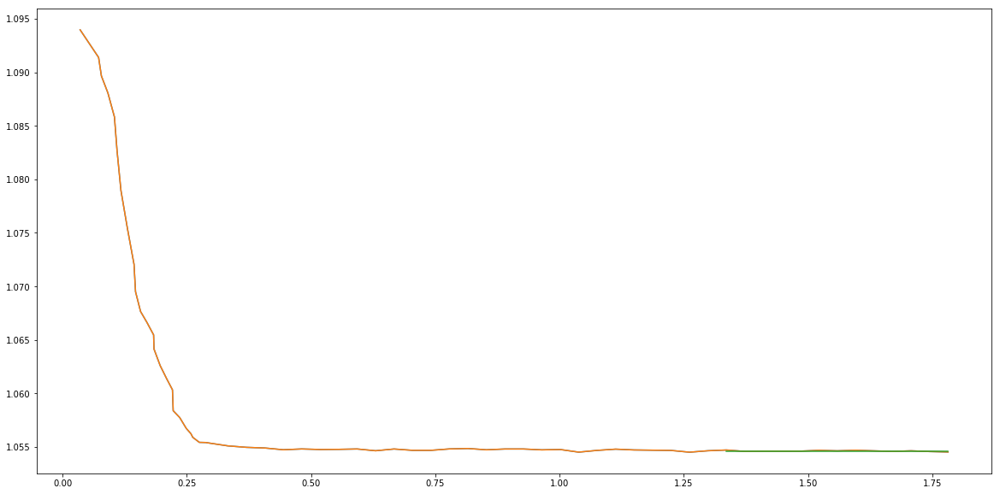

case: 19
Alert! there is nan in x, y array
T mean= 1.1515529429429447 ss= 1.28525045830766 fmean= 1.1161019266930392


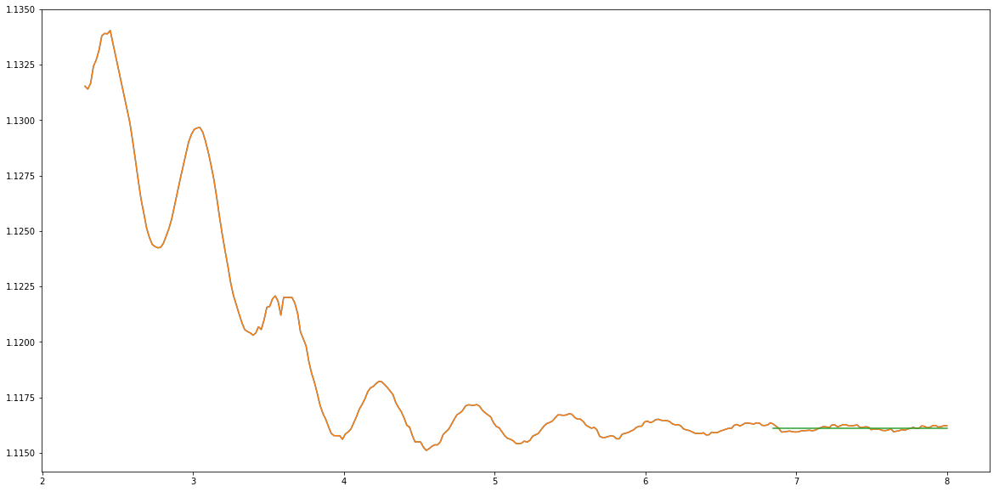

case: 20
Alert! there is nan in x, y array
T mean= 1.8518191017173051 ss= 2.088814692792991 fmean= 1.1279798825143912


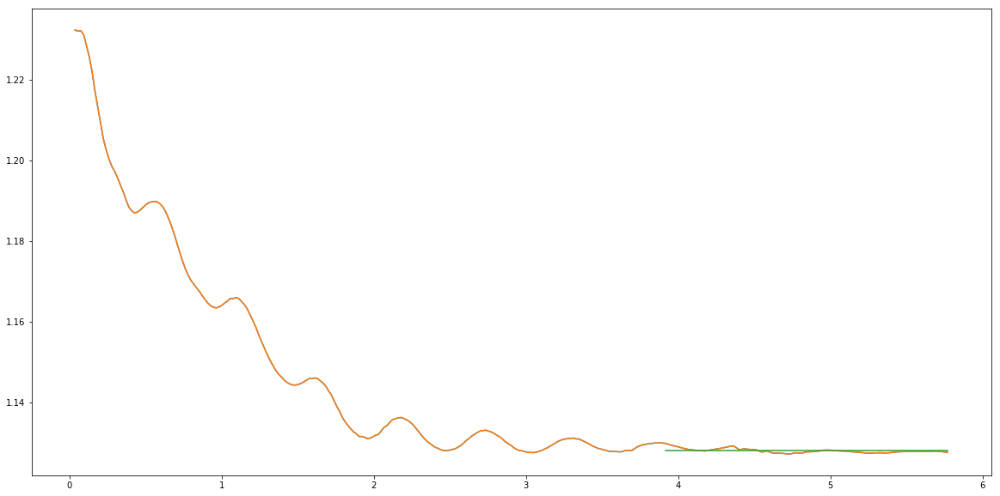

case: 21
T mean= 1.7441105008944535 ss= 2.0654227868608794 fmean= 1.18422702334608


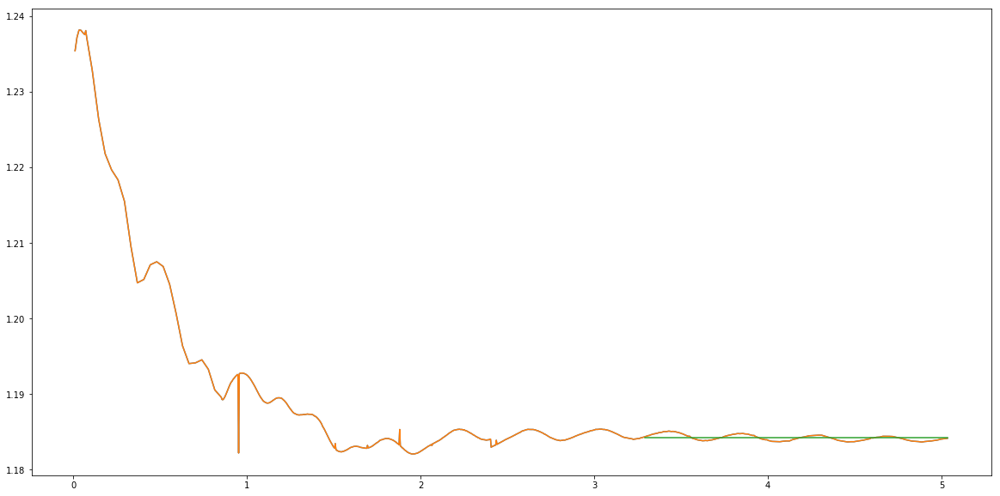

case: 22
T mean= 1.3825624050632905 ss= 1.7560964366036622 fmean= 1.27017516907186


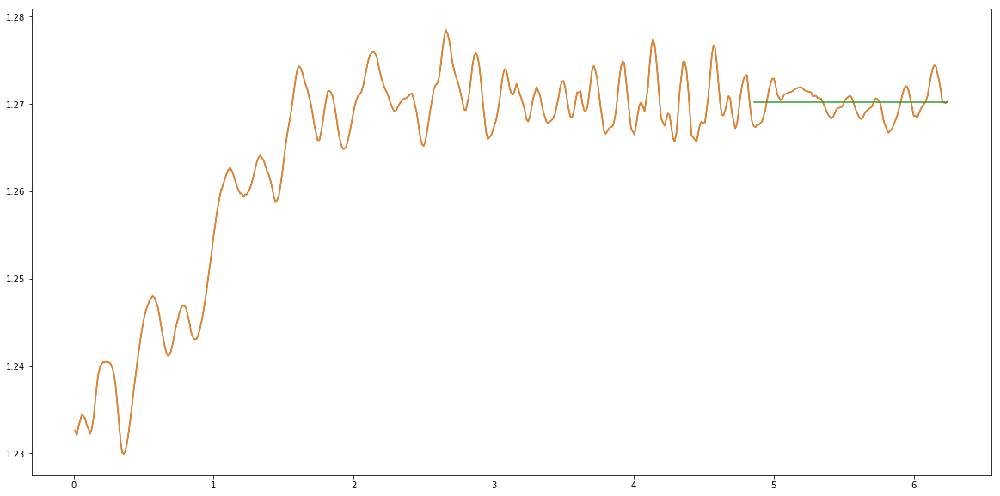

case: 23
T mean= 1.0265528155339814 ss= 1.407468838451864 fmean= 1.3710632489179253


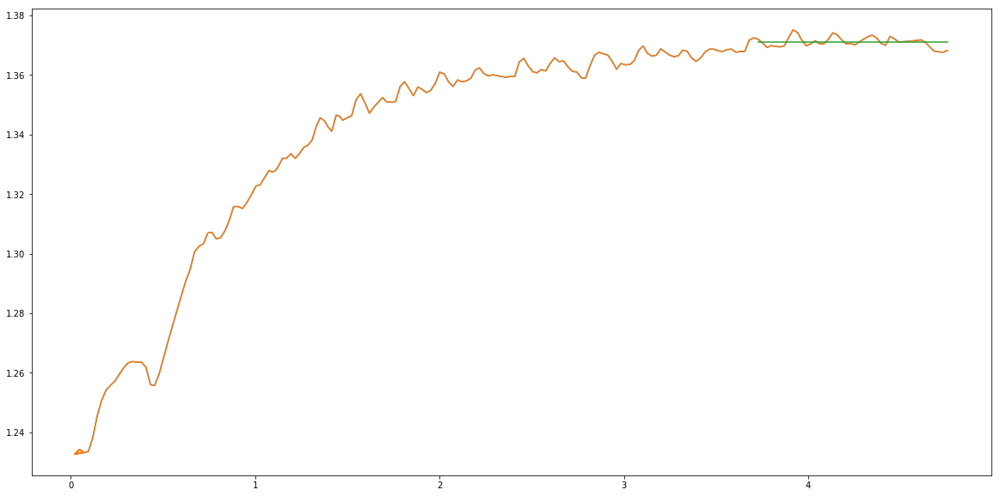

case: 24
T mean= 0.6091169475728155 ss= 0.8693157653525931 fmean= 1.4271738273193797


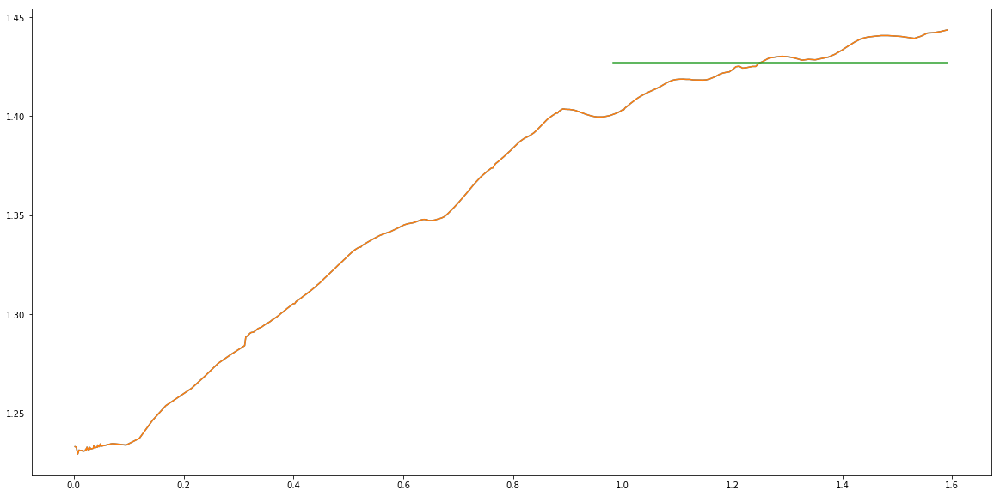

case: 25
T mean= 0.22788913592233012 ss= 0.2944623060936106 fmean= 1.2921296353239506


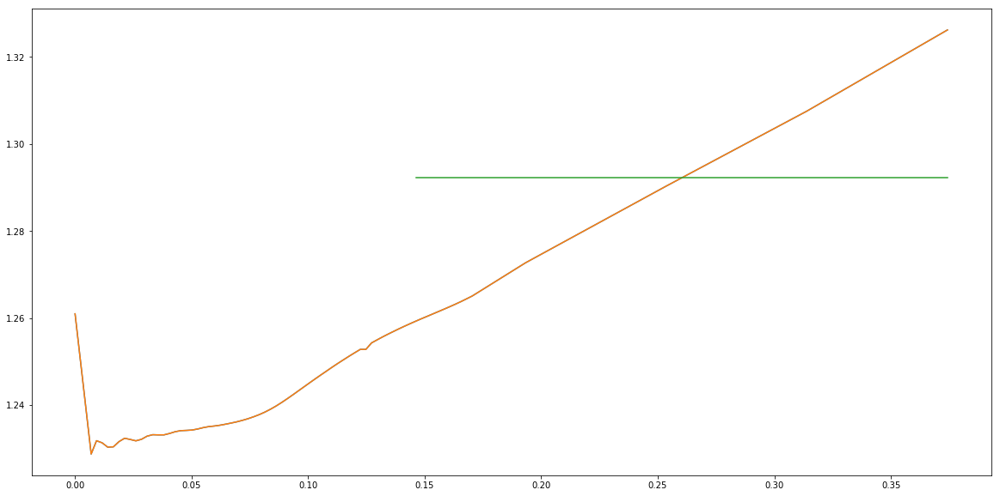

In [210]:
cases = ['18', '19', '20', '21', '22', '23', '24', '25']
# cases = [ '22']
case_names = {'18':'AW1','19':'AW2', '20':'AW3', '21':'AW4', '22':'AW5-a'}
umean = {}
for case in cases:
    print('case:', case)
    x=tab[case]['t_ms'].values
    y=tab[case]['UmeanV'].values
    x_mean, y_smooth, f_std = mean_value(x, y, frac=0.8)
    umean[case] = y_smooth[0]
    plt.figure(figsize=(20,10))
    plt.plot(tab[case]['t_ms'], tab[case]['UmeanV'])
    plt.plot(x, y)
    plt.plot(x_mean, y_smooth)
    plt.show()

case: 18
T mean= 9.345454545454512 ss= 0.12606223746315226 fmean= 0.013489149923099998


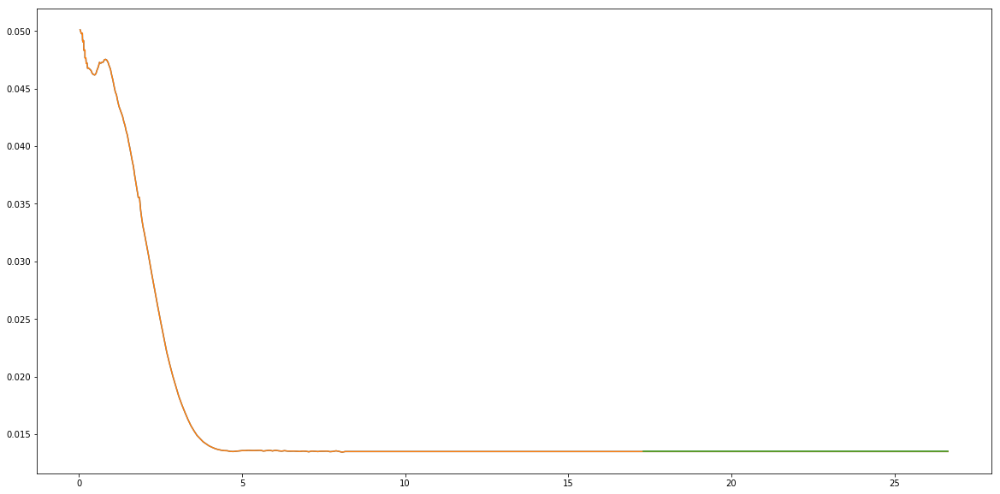

case: 19
T mean= 3.157009766067013 ss= 0.08849713707185161 fmean= 0.02803194910039854


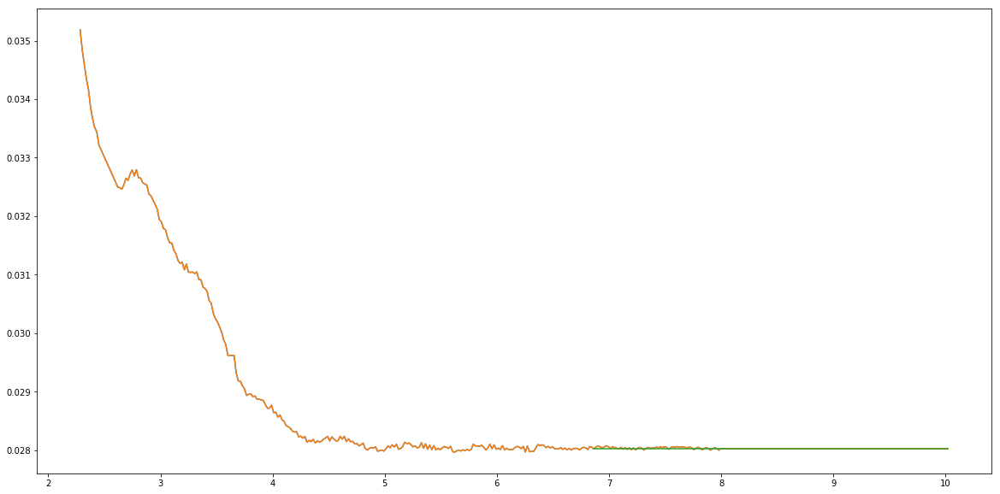

case: 20
T mean= 4.800894516557976 ss= 0.1491603437485249 fmean= 0.03106928161701543


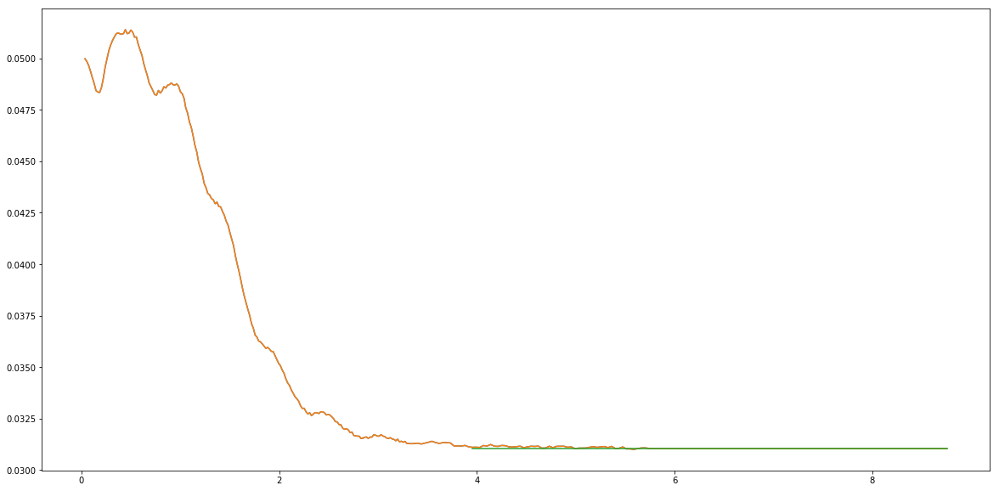

case: 21
T mean= 1.7441105008944535 ss= 0.09141478252211449 fmean= 0.05241341215205867


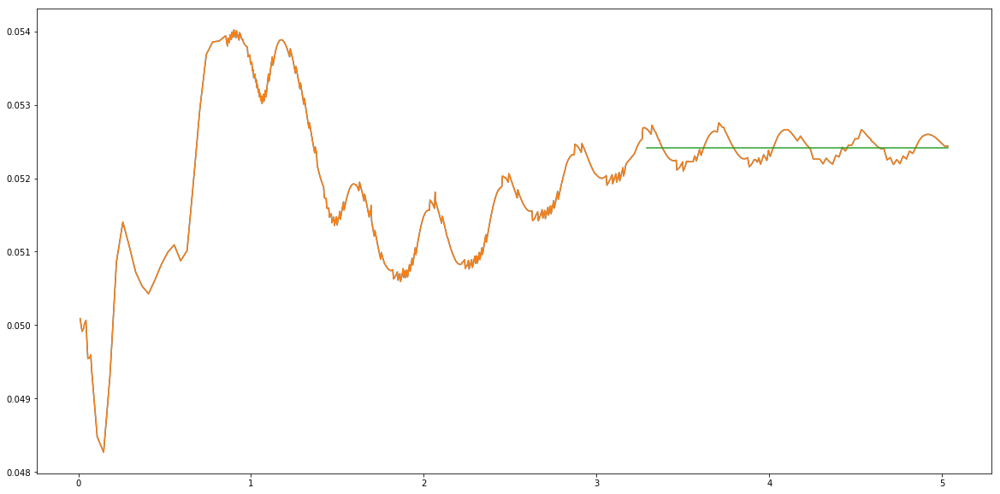

case: 22
T mean= 1.3825624050632905 ss= 0.09912583154692912 fmean= 0.0716971842890458


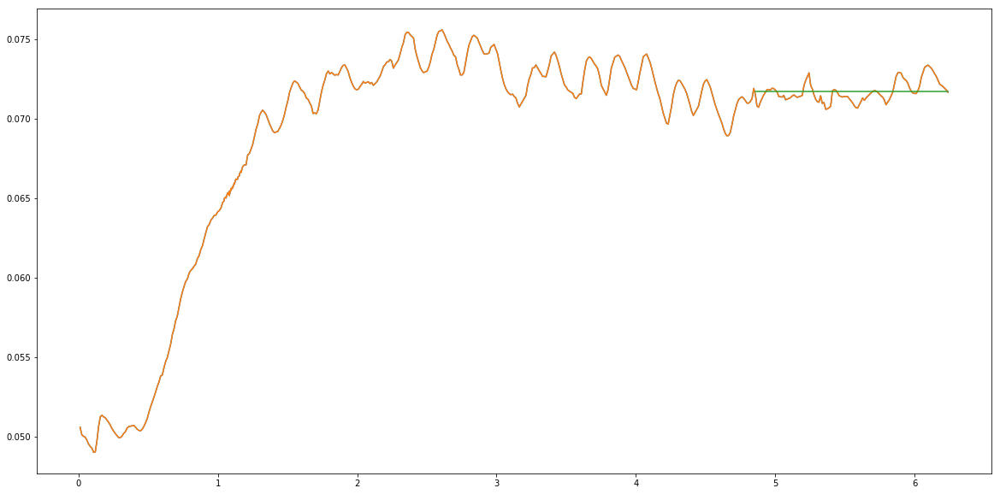

case: 23
T mean= 1.0265528155339814 ss= 0.1090348253564371 fmean= 0.1062145305204979


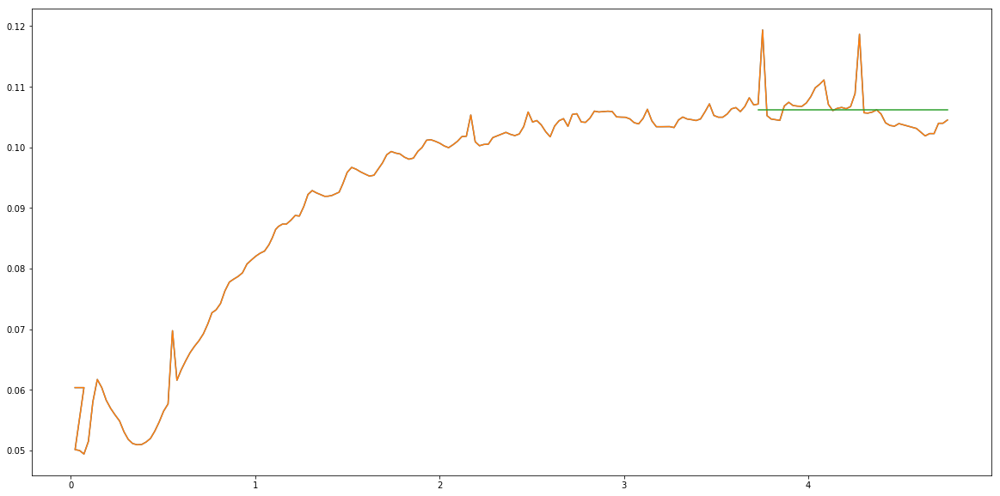

case: 24
T mean= 0.6091169475728155 ss= 0.07281263135083998 fmean= 0.11953801587852841


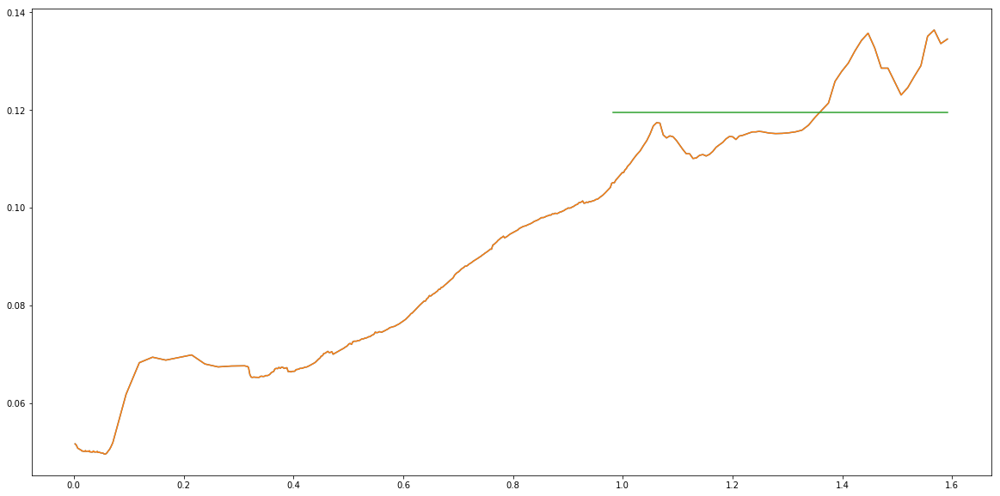

case: 25
T mean= 0.22788913592233012 ss= 0.019154072701663524 fmean= 0.08404995974969019


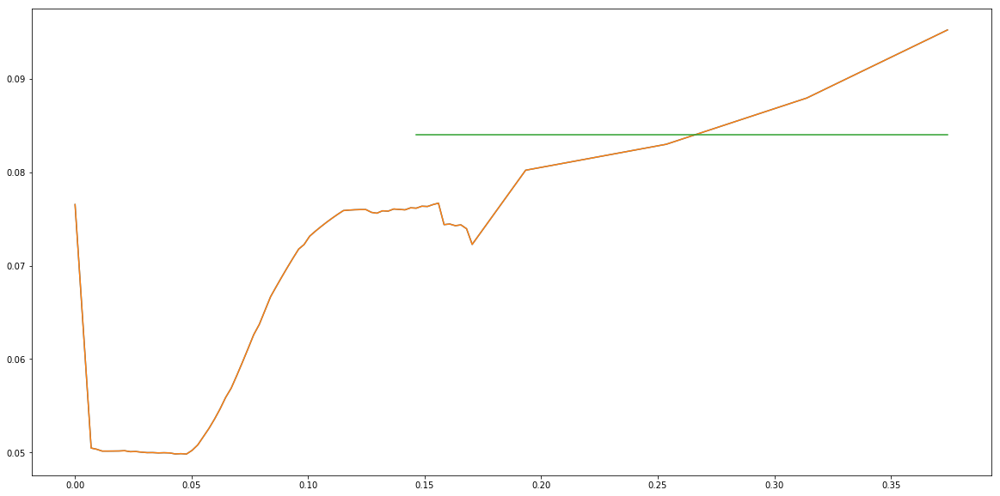

In [106]:
cases = ['18', '19', '20', '21', '22', '23', '24', '25']
# cases = [ '22']
case_names = {'18':'AW1','19':'AW2', '20':'AW3', '21':'AW4', '22':'AW5-a'}
umean = {}
for case in cases:
    print('case:', case)
    x=tab[case]['t_ms'].values
    y=tab[case]['delta_mean'].values
    x_mean, y_smooth, f_std = mean_value(x, y, frac=0.8)
    umean[case] = y_smooth[0]
    plt.figure(figsize=(20,10))
    plt.plot(tab[case]['t_ms'], tab[case]['delta_mean'])
    plt.plot(x, y)
    plt.plot(x_mean, y_smooth)
    plt.show()

In [107]:
tab['total']['Ca_Kh'], tab['total']['Umean_m_s_Kh'], tab['total']['Uflow_m_s'], -tab['total']['Uflow_m_s'] + tab['total']['Umean_m_s_Kh']

(0    0.0030
 1    0.0080
 2    0.0098
 3    0.0150
 4    0.0230
 Name: Ca_Kh, dtype: float64, 0    0.261
 1    0.704
 2    0.815
 3    1.293
 4    1.944
 Name: Umean_m_s_Kh, dtype: float64, 0    0.242
 1    0.666
 2    0.757
 3    1.118
 4    1.580
 Name: Uflow_m_s, dtype: float64, 0    0.019
 1    0.038
 2    0.058
 3    0.175
 4    0.364
 dtype: float64)

In [55]:
for case in cases_all:
    print(tab[case]['Uflow_m_s'].iloc[0])
    
tab['total']['Umean_Fer'] = [None, None, 0.757, 1.118, 1.47, None, None, None] 
tab['total']['Ub_Fer']    = [None, None, 0.815, 1.293, 1.820, None, None, None] 

tab['total']['Ub_interFoam2D'] = [None, None, 0.863, 1.344, 1.880, None, None, None]
tab['total']['Ub_flexCLV2D'] = [None, None, 0.853, 1.319, 1.836, None, None, None]
tab['total']['Ub_flexCLV3D'] = [None, None, 0.851, 1.326, 1.837, None, None, None]

tab['total']['delta_interFoam2D'] = [None, None, 0.0326, 0.0518, 0.0751, None, None, None]
tab['total']['delta_flexCLV2D'] = [None, None, 0.0296, 0.0468, 0.0650, None, None, None]
tab['total']['delta_flexCLV3D'] = [None, None, 0.0264, 0.0482, 0.0651, None, None, None]
tab['total']

0.242
0.666
0.757
1.118
1.58
2.06
2.575
3.09


,cases,Ca,Uflow_m_s,U_meanVT,U_meanVT_std,U_meanVT_m_s,delta_min,delta_min_std,deltaVT,deltaVT_std,delta_max,delta_max_std,Ca_Kh,delta*_Kh,Umean_m_s_Kh,errDelta_Kh,errDeltaMin_Kh,errorU_Kh,delta*_F,Umean_m_s_F,errorDelta_F,errorU_F,Umean_Fer,Ub_Fer,Ub_interFoam2D,Ub_flexCLV2D,Ub_flexCLV3D,delta_interFoam2D,delta_flexCLV2D,delta_flexCLV3D
0,18,0.003085,0.242,1.054677,0.000092,0.255232,0.012353,0.005279,0.020003,0.011543,0.023670,0.014855,0.0030,0.013,0.261,0.538669,0.049754,0.022101,0.0000,0.000,0.000000,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,19,0.008985,0.666,1.116105,0.000101,0.743326,0.015814,0.000037,0.028038,0.000018,0.035223,0.000057,0.0080,0.023,0.704,0.219061,0.312414,0.055861,0.0000,0.000,0.000000,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,20,0.010319,0.757,1.127709,0.000174,0.853675,0.016997,0.000104,0.031070,0.000046,0.041036,0.000259,0.0098,0.025,0.815,0.242816,0.320118,0.047454,0.0277,0.815,0.121675,0.047454,0.757,0.815,0.863,0.853,0.851,0.0326,0.0296,0.0264
3,21,0.016083,1.118,1.190081,0.004811,1.330510,0.024124,0.001696,0.054656,0.001083,0.084110,0.002793,0.0150,0.039,1.293,0.401434,0.381424,0.029010,0.0437,1.293,0.250708,0.029010,1.118,1.293,1.344,1.319,1.326,0.0518,0.0468,0.0482
4,22,0.024262,1.580,1.270328,0.002339,2.007118,0.030749,0.009776,0.071798,0.001059,0.081775,0.008397,0.0230,0.054,1.944,0.329599,0.430581,0.032468,0.0634,1.820,0.132466,0.102812,1.470,1.820,1.880,1.836,1.837,0.0751,0.0650,0.0651
5,23,0.034000,2.060,1.370874,0.002196,2.824000,0.106000,0.010179,0.040000,0.003174,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,24,0.045500,2.575,1.460194,0.001075,3.760000,0.137000,0.013329,0.066000,0.001642,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,25,0.056000,3.090,1.504854,0.010572,4.650000,0.150000,0.011637,0.071600,0.007653,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [34]:
tab['total']['Ca'], Mu1*tab['total']['U_meanVT_m_s']/Sigma

(0    0.003085
 1    0.008985
 2    0.010319
 3    0.016083
 4    0.024262
 5    0.034000
 6    0.045500
 7    0.056000
 Name: Ca, dtype: float64, 0    0.003085
 1    0.008985
 2    0.010319
 3    0.016083
 4    0.024262
 5    0.034136
 6    0.045451
 7    0.056209
 Name: U_meanVT_m_s, dtype: float64)

# W=(Ub-Umean)/Ub vs Ca

In [63]:
import scipy.stats as stats

Ub_meth_names= ['Ub_interFoam2D', 'Ub_flexCLV2D', 'Ub_flexCLV3D' ]
delta_meth_names = ['delta_interFoam2D', 'delta_flexCLV2D', 'delta_flexCLV3D']
list_name = ['present work', 'interFoam (2D)       ', 'flexCLV (2D)       ', 'flexCLV (3D)       ' , 'Khodaparast et al. (exp)       ', 'Bretherton       ']# 'Ferrari et al. (exp)',
cases_all = ['18', '19', '20', '21', '22', '23', '24', '25']

listx, listy = [], []
bpmx, bpmy = [], []
list_errors=[]
u_bub_mean = {}
u_bub_std = {}

Mu1 = 0.88e-3;
Sigma = 72.8e-3;
for case in cases_all:
    print(case)
    x=tab[case]['t_ms'].values
    y=tab[case]['UmeanV'].values*vel_norm[case]
    x_mean, y_smooth, f_std = mean_value(x, y, frac=0.8)
    u_bub_mean[case] = y_smooth[0]
    u_bub_std[case] = f_std
    
    Ca = Mu1*u_bub_mean[case]/Sigma #tab[case]['Ca'].iloc[1]
    Ub = u_bub_mean[case]
    Umean = tab[case]['Uflow_m_s'].iloc[0]
    x = Ca
    y = (Ub - Umean)/Ub
    bpmx.append(x)
    bpmy.append(y)
    list_errors.append(f_std)
slope, intercept, r_value, p_value, std_err = stats.linregress(bpmx, bpmy)

outx, outy = [], []
for meth in Ub_meth_names:
    Umean = tab['total']['Umean_Fer'].values#tab['total']['Uflow_m_s'].values
    Ub = tab['total'][meth].values
    Ca = Mu1*Ub/Sigma
    W = (Ub - Umean)/Ub
    outx.append(Ca)
    outy.append(W)
    

Ca_ = np.linspace(0.003, 0.06,100)
W_ = 1.29*(3*Ca_)**(2./3.)
# W_ = slope*Ca_ + intercept

# #Khodaparast

Ub = tab['total']['Umean_m_s_Kh'].values
Umean = tab['total']['Uflow_m_s'].values
Ca = Mu1*Ub/Sigma#tab['total']['Ca_Kh'].values
list_x_exp = Ca
list_y_exp = (Ub - Umean)/Ub
list_err_exp = list_y_exp*0.005

#Ferrari
# Ub = tab['total']['Ub_Fer'].values
# Umean = tab['total']['Umean_Fer'].values
# Ca = Mu1*Ub/Sigma
# list_x_exp = Ca
# list_y_exp = (Ub - Umean)/Ub

listx = [bpmx]
listy = [bpmy]
listx +=outx
listy +=outy
listx += [list_x_exp, Ca_]#, list_x_F
listy += [list_y_exp, W_]#, list_y_F

list_errors = [list_errors, [], [], [], list_err_exp, []]
add_error_bar = [True] + [False]*3 + [True] + [False]
fn = 'W_vs_Ca.eps'

plot_graph(listx, listy, names=list_name, xtitle='Ca', ytitle='$(U_b - U_{\mathrm{mean}})/U_{\mathrm{mean}}$', \
               image_name=fn, list_errors=list_errors, add_error_bar=add_error_bar, mode=['lines+markers']*5+['lines'],\
#                xrange=[0,4], \
               yrange=[0,0.28],\
#                xlog=True, ylog=True,\
               dash=['solid', 'solid', 'solid', 'solid', 'dash', 'dash', 'solid', 'dash'],\
               colors=['blue', 'red', 'hsv(120,100,100)', 'green', 'indigo', 'aqua', 'goldenrod', 'black', 'pink'],\
               marker_size=8,\
               marker_style = ['circle', 'triangle-up', 'triangle-down','square', 'diamond', 'cross',  'x-thin', 'cross-thin', 'circle', 'triangle-up', 'triangle-down' ],\
               width=1000, height=500, path=rpath, yanchor='top', y0_anchor=0.99, xanchor='left', x0_anchor=0.01, legend_orientation='h',
               legendfont_size=17, 
               tickfont_size=17, titlefont_size=18 
          ) 



18
Alert! there is nan in x, y array
T mean= 0.44577393388429787 ss= 0.1137698087203923 fmean= 0.2552186210823212
19
Alert! there is nan in x, y array
T mean= 1.1515529429429447 ss= 0.8559768052329016 fmean= 0.7433238831775641
20
Alert! there is nan in x, y array
T mean= 1.8518191017173051 ss= 1.581232722444294 fmean= 0.8538807710633939
21
T mean= 1.7441105008944535 ss= 2.3091426757104636 fmean= 1.3239658121009177
22
T mean= 1.3825624050632905 ss= 2.7746323698337862 fmean= 2.0068767671335386
23
T mean= 1.0265528155339814 ss= 2.8993858072108405 fmean= 2.8243902927709263
24
T mean= 1.235873576699029 ss= 4.6078297199703675 fmean= 3.728398929183116
25
T mean= 0.3451950809061488 ss= 1.5928553480237209 fmean= 4.614362823022916


Successfully generated: /Users/weugene/basilisk/work/tube/W_vs_Ca.eps


In [36]:
tab['total']

,cases,Ca,Uflow_m_s,U_meanVT,U_meanVT_std,U_meanVT_m_s,delta_min,delta_min_std,deltaVT,deltaVT_std,delta_max,delta_max_std,Ca_Kh,delta*_Kh,Umean_m_s_Kh,errDelta_Kh,errDeltaMin_Kh,errorU_Kh,delta*_F,Umean_m_s_F,errorDelta_F,errorU_F
0,18,0.003085,0.242,1.054677,0.000092,0.255232,0.012353,0.005279,0.020003,0.011543,0.023670,0.014855,0.0030,0.013,0.261,0.538669,0.049754,0.022101,0.0000,0.000,0.000000,0.000000
1,19,0.008985,0.666,1.116105,0.000101,0.743326,0.015814,0.000037,0.028038,0.000018,0.035223,0.000057,0.0080,0.023,0.704,0.219061,0.312414,0.055861,0.0000,0.000,0.000000,0.000000
2,20,0.010319,0.757,1.127709,0.000174,0.853675,0.016997,0.000104,0.031070,0.000046,0.041036,0.000259,0.0098,0.025,0.815,0.242816,0.320118,0.047454,0.0277,0.815,0.121675,0.047454
3,21,0.016083,1.118,1.190081,0.004811,1.330510,0.024124,0.001696,0.054656,0.001083,0.084110,0.002793,0.0150,0.039,1.293,0.401434,0.381424,0.029010,0.0437,1.293,0.250708,0.029010
4,22,0.024262,1.580,1.270328,0.002339,2.007118,0.030749,0.009776,0.071798,0.001059,0.081775,0.008397,0.0230,0.054,1.944,0.329599,0.430581,0.032468,0.0634,1.820,0.132466,0.102812
5,23,0.034000,2.060,1.370874,0.002196,2.824000,0.106000,0.010179,0.040000,0.003174,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,24,0.045500,2.575,1.460194,0.001075,3.760000,0.137000,0.013329,0.066000,0.001642,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,25,0.056000,3.090,1.504854,0.010572,4.650000,0.150000,0.011637,0.071600,0.007653,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


# Ub vs Umean

In [57]:
import scipy.stats as stats


list_name = ['BPM', 'interFoam (2D)', 'flexCLV (2D)', 'flexCLV (3D)' , 'Khodaparast et al. (exp)', 'Bretherton']
cases_all = ['18', '19', '20', '21', '22', '23', '24', '25']

listx, listy = [], []
list_errors=[]
for case in cases_all:
    print(case)
    Ca = Mu1*u_bub_mean[case]/Sigma #tab[case]['Ca'].iloc[1]
    Ub = u_bub_mean[case]
    Umean = tab[case]['Uflow_m_s'].iloc[0]
    x = Umean
    y = Ub
    listx.append(x)
    listy.append(y)

    
#     Ca = tab[case]['Ca'].iloc[1]
#     Ub = tab[case]['U_meanVT_m_s'].iloc[0]
#     Umean = tab[case]['Uflow_m_s'].iloc[0]
#     x = Umean
#     y = Ub
#     listx.append(x)
#     listy.append(y)
    list_errors.append(u_bub_std)
slope, intercept, r_value, p_value, std_err = stats.linregress(listx, listy)

outx, outy = [], []
for meth in Ub_meth_names:
    Umean = tab['total']['Umean_Fer'].values #tab['total']['Uflow_m_s'].values
    Ub = tab['total'][meth].values
    outx.append(Umean)
    outy.append(Ub)

Ub_app = np.linspace(min(listy), max(listy), 100)
Umean_app = Ub_app - 1.29*(3*Mu1/Sigma)**(2./3.)*Ub_app**(5./3.)
listx_app = Umean_app
listy_app = Ub_app


Ub = tab['total']['Umean_m_s_Kh'].values
Umean = tab['total']['Uflow_m_s'].values
list_x_Kh = Umean
list_y_Kh = Ub

list_name[2] = "U<sub>mean</sub>=U<sub>b</sub>(1 - 1.29(3\u03bcU<sub>b</sub>/\u03c3)<sup>2/3</sup>)".format(np.round(slope, 2))
listx = [listx]
listy = [listy]
listx += outx
listy += outy
listx += [list_x_Kh, listx_app]
listy += [list_y_Kh, listy_app]

list_errors = [list_errors]
add_error_bar = [True]*1 + [False]*10
fn = 'Ub_vs_Umean.eps'

plot_graph(listx, listy, names=list_name, xtitle='U<sub>mean</sub>', ytitle='U<sub>b</sub>', \
               image_name=fn, list_errors=list_errors, add_error_bar=add_error_bar, mode=['lines+markers']*4 + ['lines']*2,\
#                xrange=[0,4], yrange=[0,0.45],\
               dash=['solid', 'solid', 'solid', 'dash', 'dash', 'dash', 'dash', 'dash'],\
               colors=['blue', 'red', 'hsv(120,100,100)', 'green', 'indigo', 'aqua', 'goldenrod', 'black', 'pink'],\
               marker_size=10,\
               marker_style = ['circle', 'triangle-up', 'triangle-down','square', 'diamond', 'cross',  'x-thin', 'cross-thin', 'circle', 'triangle-up', 'triangle-down' ],\
               width=1000, height=500, path=rpath, yanchor='bottom', y0_anchor=0.01, xanchor='right', x0_anchor=0.99, legend_orientation='h',
               legendfont_size=15, tickfont_size=15, titlefont_size=18)



18
19
20
21
22
23
24
25


Successfully generated: /Users/weugene/basilisk/work/tube/Ub_vs_Umean.eps


# Ub-Utheory vs Umean

In [60]:
import scipy.stats as stats
from scipy import optimize
from scipy.optimize import fsolve

def Umeanapp(Ub_app):
    return Ub_app - 1.29*(3*Mu1/Sigma)**(2./3.)*Ub_app**(5./3.)

def Fun(Ub_app, *args):
    Umean=args
    return Umeanapp(Ub_app) - Umean
    
def Ububapp(Umean):
    out = []
    if isinstance(Umean, (list, tuple, np.ndarray)):
        for u in Umean:
            out.append(fsolve(Fun, [1], args=(u))[0])
        return out
    else:
        return fsolve(Fun, [1], args=(Umean))[0]

list_name = ['BPM', 'Khodaparast (exp)', 'Approximation']
cases_all = ['18', '19', '20', '21', '22', '23', '24', '25']

Ub_app = np.linspace(0.242, 1.58, 100)
Umean_app = Umeanapp(Ub_app)

listx_app = Umean_app
listy_app = Ub_app - Ububapp(Umean_app)

import scipy.stats as stats


list_name = ['BPM', 'Khodaparast', 'Approximation']
cases_all = ['18', '19', '20', '21', '22', '23', '24', '25']

listx, listy = [], []
list_errors=[]
for case in cases_all:
    print(case)
    Ca = Mu1*u_bub_mean[case]/Sigma #tab[case]['Ca'].iloc[1]
    Ub = u_bub_mean[case]
    Umean = tab[case]['Uflow_m_s'].iloc[0]
    x = Umean
    y = Ub - Ububapp(x)
    listx.append(x)
    listy.append(y)
    
    
#     Ca = tab[case]['Ca'].iloc[1]
#     Ub = tab[case]['U_meanVT_m_s'].iloc[0]
#     Umean = tab[case]['Uflow_m_s'].iloc[0]
#     x = Umean
#     y = Ub
#     listx.append(x)
#     listy.append(y)
    list_errors.append(u_bub_std)
slope, intercept, r_value, p_value, std_err = stats.linregress(listx, listy)




Ub = tab['total']['Umean_m_s_Kh'].values
Umean = tab['total']['Uflow_m_s'].values
list_x_Kh = Umean
list_y_Kh = Ub - Ububapp(Umean)

list_name[2] = "U<sub>mean</sub>=U<sub>b</sub>(1 - 1.29(3\u03bcU<sub>b</sub>/\u03c3)<sup>2/3</sup>)".format(np.round(slope, 2))
listx = [listx, list_x_Kh]
listy = [listy, list_y_Kh]

list_errors = [list_errors]
add_error_bar = [True, False, False]
fn = 'Ub-Ub_breth_vs_Umean.eps'

plot_graph(listx, listy, names=list_name, xtitle='U<sub>mean</sub>', ytitle='U<sub>b</sub>', \
               image_name=fn, list_errors=list_errors, add_error_bar=add_error_bar, mode=['lines+markers','lines+markers','lines','lines','lines','lines','lines','lines','lines','lines','lines','lines'],\
#                xrange=[0,4], yrange=[0,0.45],\
               dash=['solid', 'solid', 'solid', 'dash', 'dash', 'dash', 'dash', 'dash'],\
               colors=['blue', 'red', 'hsv(120,100,100)', 'green', 'indigo', 'aqua', 'goldenrod', 'black', 'pink'],\
               marker_size=10,\
               marker_style = ['circle', 'triangle-up', 'triangle-down','square', 'diamond', 'cross',  'x-thin', 'cross-thin', 'circle', 'triangle-up', 'triangle-down' ],\
               width=1000, height=500, path=rpath, yanchor='bottom', y0_anchor=0.01, xanchor='right', x0_anchor=0.99, legend_orientation='h')



18
19
20
21
22
23
24
25


Successfully generated: /Users/weugene/basilisk/work/tube/Ub-Ub_breth_vs_Umean.eps


In [207]:
Umean

array([0.242, 0.666, 0.757, 1.118, 1.58 ])

# $\delta_{mean}$ over $Ca$  + $\bar{\delta}_\min, \mathrm{BPM}$

In [62]:
import scipy.stats as stats
delta_meth_names = ['delta_interFoam2D', 'delta_flexCLV2D', 'delta_flexCLV3D']
# deltas = ['min', 'mean', 'max']
deltas = ['min', 'mean']
list_name = [u'$\delta_\min$', u'$\delta_\mathrm{avg}$', u'$\delta_\mathrm{*}$', 
             'interFoam (2D)       ', 'flexCLV (2D)       ', 'flexCLV (3D)       ' ,
             'Khodaparast et al. (exp)       ','Ferrari et al. (exp)      ', 'Aussillous & Qu\u00e9r\u00e9       ', 'Goldsmith & Mason (emp)     ', 'test']# 'Ferrari et al. (exp)',
#              'Khodaparast et al. (exp)','Ferrari et al. (exp)', 'Aussillous and Qu\u00e9r\u00e9', 'Goldsmith and Mason (exp)', 'test']# 'Ferrari et al. (exp)',

cases_all = ['18', '19', '20', '21', '22', '23', '24', '25']

def Goldsmith_Mason_delta(Umean, Ub):
    return 0.5*(1 - np.sqrt(Umean/Ub))

delta_bpm_mean, delta_bpm_std = {}, {}
delta_bpm_gm_mean, delta_bpm_gm_std = {}, {}
listx, listy =[], []
bpmx, bpmy = [], []
list_errors=[]
for i,delta_label in enumerate(deltas):
    x, y, e = [], [], []
    delta_bpm_mean[delta_label]={}
    delta_bpm_std[delta_label]={}
    delta_bpm_gm_mean[delta_label]={}
    delta_bpm_gm_std[delta_label]={}
    for case in cases_all:
        xs = tab[case]['t_ms'].values/1000
        ys = tab[case]['delta_' + delta_label].values
        xs = xs[~np.isnan(ys)]
        ys = ys[~np.isnan(ys)]
        
        x_mean, y_smooth, f_std = mean_value(xs, ys, frac=0.8)
        delta_bpm_mean[delta_label][case] = y_smooth[0]
        delta_bpm_std[delta_label][case] = f_std
        Umean = tab['total']['Uflow_m_s'].values
        Ub = u_bub_mean[case]
        delta_bpm_mean[delta_label][case] = Goldsmith_Mason_delta(Umean, Ub)
        delta_bpm_std[delta_label][case] = f_std
        
        Ca = Mu1*u_bub_mean[case]/Sigma
        delta_zv = y_smooth[0]
        x.append(Ca)
        y.append(delta_zv)
        e.append(f_std)
    bpmx.append(x)
    bpmy.append(y)
    list_errors.append(e)
    slope, intercept, r_value, p_value, std_err = stats.linregress(x, y)

x, y =[], []
delta_bpm_gm_mean={}
delta_bpm_gm_std={}
for i,case in enumerate(cases_all):
    Umean = tab['total']['Uflow_m_s'].values[i]
    Ub = u_bub_mean[case]
    delta_bpm_gm_mean[case] = Goldsmith_Mason_delta(Umean, Ub)
    delta_bpm_gm_std[case] = f_std

    Ca = Mu1*Ub/Sigma
    x.append(Ca)
    y.append(delta_bpm_gm_mean[case])
    e.append(f_std)
bpmx.append(x)
bpmy.append(y)
list_errors.append([])
    

outx, outy = [], []
for meth in delta_meth_names:
    key = 'Ub' + meth[5:]
    Umean = tab['total']['Umean_Fer'].values#tab['total']['Uflow_m_s'].values
    Ub = tab['total'][key].values
    Ca = Mu1*Ub/Sigma
    W = (Ub - Umean)/Ub
    deltazv = tab['total'][meth].values
    outx.append(Ca)
    outy.append(deltazv)
    list_errors.append([])
    
#     Ca_ = np.linspace(0.003, 0.03,100)
#     W_ = slope*Ca_ + intercept
# Ca = tab['total']['Ca_Kh']
# delta_zv = tab['total']['delta*_Kh']
# list_x_Kh = Ca
# list_y_Kh = delta_zv
# listx.append(list_x_Kh)
# listy.append(list_y_Kh)

#Khodaparast
Ub = tab['total']['Umean_m_s_Kh'].values
Umean = tab['total']['Uflow_m_s'].values
Ca = Mu1*Ub/Sigma
deltazv = tab['total']['delta*_Kh'].values
list_x_Kh = Ca
list_y_Kh = deltazv
err = np.where(Ca > 0.003, 0.1*deltazv, 0.3*deltazv)
list_errors.append(err)

#Ferrari
Ub = tab['total']['Ub_Fer'].values
Umean = tab['total']['Umean_Fer'].values
Ca = Mu1*Ub/Sigma
deltazv =  tab['total']['delta*_F'].values
list_x_F = Ca
list_y_F = deltazv
err = np.where(Ca > 0.003, 0.1*deltazv, 0.3*deltazv)
list_errors.append(err)

#Aussillous and Quere
Ca_ = np.linspace(0.003, 0.06, 100)
# Re_ = 997*tab['total']['Umean_m_s_Kh']*diam/Mu1
# delta_zv = 2*Ca**(2./3.)/(1 + Ca**(2./3.0) - Re_*Ca)# here 2 because in Magnini & Stone article h0/R
delta_zv_ = 0.67*Ca_**(2./3.)/( 1 + 3.35*Ca_**(2./3.))

#Goldsmith and Mason

# Ub = tab['total']['Ub_Fer'].values
# Umean = tab['total']['Umean_Fer'].values
# Ca_gm = Mu1*Ub/Sigma
# delta_zv_gm = Goldsmith_Mason_delta(Umean, Ub)
# Ub = tab['total']['U_meanVT_m_s'].values
# Umean = tab['total']['Uflow_m_s'].values
# Ca_gm = tab['total']['Ca']
# delta_zv_gm = Goldsmith_Mason_delta(Umean, Ub)


listx += bpmx
listy += bpmy
listx +=outx
listy +=outy
listx += [list_x_Kh, list_x_F, Ca_]#, 
listy += [list_y_Kh, list_y_F, delta_zv_]#, 
# listx += [list_x_Kh, list_x_F, Ca_, Ca_gm]#, 
# listy += [list_y_Kh, list_y_F, delta_zv_, delta_zv_gm]#, 



add_error_bar = [True]*(len(deltas)) + [False]*4 + [True]*2 + [False]*2
fn = 'delta_vs_Ca.eps'
solid_num = len(bpmx) + len(outx)
plot_graph(listx, listy, names=list_name, xtitle='Ca', ytitle='$\large\delta$', \
               image_name=fn, list_errors=list_errors, add_error_bar=add_error_bar, mode=['lines+markers']*(solid_num+2)+['lines']*10,\
               xrange=[0.0025,0.025], \
               yrange=[0,0.10],\
               dash=['solid']*solid_num + ['dash']*10,\
               colors=['blue', 'red', 'hsv(120,100,100)', 'green', 'indigo', 'aqua', 'orange', 'black', 'rgb(214, 39, 40)', 'rgb(227, 119, 194)'],\
               marker_size=10,line_size=2, \
               marker_style = ['circle-open', 'triangle-up-open', 'triangle-down-open','square-open', 'diamond-open', 'circle-open',  'circle-open', 'triangle-up-open', 'circle', 'triangle-up', 'triangle-down' ],\
               width=1000, height=500, path=rpath, yanchor='top', y0_anchor=0.99, xanchor='left', x0_anchor=0.01, legend_orientation='h', ylog=False,
               legendfont_size=17, 
               tickfont_size=17, titlefont_size=18 
          )



T mean= 0.009345454545454511 ss= 8.583153335889714e-05 fmean= 0.009184308044240001
T mean= 0.0031570097660670133 ss= 4.989715970034976e-05 fmean= 0.015805196498492744
T mean= 0.004800894516557977 ss= 8.117407409554744e-05 fmean= 0.016908114480662567
T mean= 0.0017441105008944536 ss= 4.089138226495597e-05 fmean= 0.023445407985322683
T mean= 0.0013825624050632906 ss= 3.648184825248454e-05 fmean= 0.02638712590395837
T mean= 0.001026552815533981 ss= 4.2670213382576185e-05 fmean= 0.04156650562628914
T mean= 0.001235873576699029 ss= 7.38836216912297e-05 fmean= 0.059782507761489675
T mean= 0.00034519508090614893 ss= 2.234217302743991e-05 fmean= 0.06472332389207558
T mean= 0.009345454545454511 ss= 0.00012606223746315225 fmean= 0.013489149923099998
T mean= 0.0031570097660670133 ss= 8.849713707185162e-05 fmean= 0.02803194910039854
T mean= 0.004800894516557977 ss= 0.00014916034374852494 fmean= 0.031069281617015432
T mean= 0.0017441105008944536 ss= 9.141478252211452e-05 fmean= 0.052413412152058685

/Users/weugene/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:96: RuntimeWarning:

invalid value encountered in greater

/Users/weugene/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:106: RuntimeWarning:

invalid value encountered in greater



Successfully generated: /Users/weugene/basilisk/work/tube/delta_vs_Ca.eps


In [515]:
print('$\bar{\delta}_\min, \mathrm{BPM}$')

$ar{\delta}_\min, \mathrm{BPM}$


In [507]:
# tab['total']['Uflow_m_s']
delta_bpm_gm_mean

{'18': 0.013120478293263294,
 '19': 0.026720083806355988,
 '20': 0.029218566148453473,
 '21': 0.040622667917852684,
 '22': 0.05635234004363315}

In [ ]:
trim={0 0 0 8cm},clip,

In [ ]:
key = 'delta_{}VT'.format(delta_label)
        Ca = tab[case]['Ca'].iloc[1]
        delta_zv = tab[case][key].iloc[0]
        x.append(Ca)
        y.append(delta_zv)
        e.append(tab[case][key].iloc[1])
    listx.append(x)
    listy.append(y)
    list_errors.append(e)
    slope, intercept, r_value, p_value, std_err = stats.linregress(x, y)

    Ca_ = np.linspace(0, 0.03,100)
    W_ = slope*Ca_ + intercept

Ca = tab['total']['Ca_Kh']
delta_zv = tab['total']['delta*_Kh']
list_x_Kh = Ca
list_y_Kh = delta_zv


listx.append(list_x_Kh)
listy.append(list_y_Kh)

#Aussillous and Quere

Ca_ = np.linspace(0.8*min(Ca), 1.1*max(Ca), 100)
Re_ = 997*tab['total']['Umean_m_s_Kh']*diam/Mu1
# delta_zv = 2*Ca**(2./3.)/(1 + Ca**(2./3.0) - Re_*Ca)# here 2 because in Magnini & Stone article h0/R
delta_zv = 0.67*Ca_**(2./3.)/( 1 + 3.35*Ca_**(2./3.))
listx.append(Ca_)
listy.append(delta_zv)

add_error_bar = [True]*len(deltas) + [False, False, False, False]
fn = 'freq_{}_x_22.png'.format("_".join(variables))

plot_graph(listx, listy, names=list_name, xtitle='Ca', ytitle='\u03b4', \
               image_name=fn, list_errors=list_errors, add_error_bar=add_error_bar, mode=['lines+markers','lines+markers','lines+markers','lines','lines','lines','lines','lines','lines','lines','lines','lines'],\
#                xrange=[0,4], yrange=[0,0.45],\
               dash=['solid', 'solid', 'solid', 'dash', 'dash', 'dash', 'dash', 'dash'],\
               colors=['blue', 'red', 'hsv(120,100,100)', 'green', 'indigo', 'aqua', 'goldenrod', 'black', 'pink'],\
               marker_size=10,\
               marker_style = ['circle', 'triangle-up', 'triangle-down','square', 'diamond', 'cross',  'x-thin', 'cross-thin', 'circle', 'triangle-up', 'triangle-down' ],\
               width=1000, height=500, path=rpath, yanchor='bottom', y0_anchor=0.01, xanchor='right', x0_anchor=0.99, legend_orientation='h', ylog=False)


# TEST FOURIER

In [234]:
# x = np.arange(0, 10*np.pi, 0.1)
# y = np.sin(x)
# x_fourier, y_fourier = myfft(x, y, [0, 10], filter_fun=None)

# # plt.plot(x, y, label='clears', x_fourier, y_fourier, label='fourier')
# plt.plot(x, y, 'b-', x_fourier, y_fourier, 'g-')
# plt.xlim([0,5])

# Calculation of a viscous damping coefficient. Damped harmonic oscillator

case 20
best popt= dict_values([-0.06290537471766153, 11.463506097270281, 17.279488338503214, 0.0198804193787665, 1.5859991600993248])


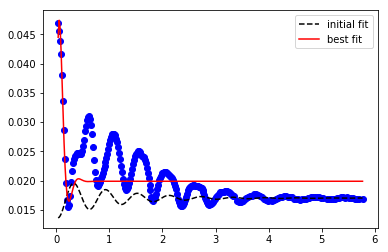

best popt= dict_values([0.06286185506619578, 11.456715229490712, 17.275602719947436, 0.01988047172863944, 92.69275023616774])


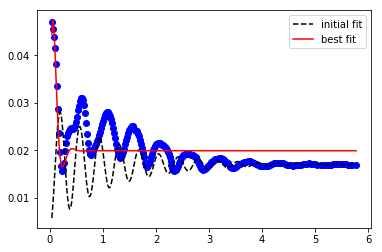

best popt= dict_values([-0.06285405207249774, 11.455500614217645, 17.274907059960952, 0.019880481018414456, 83.26807306935186])


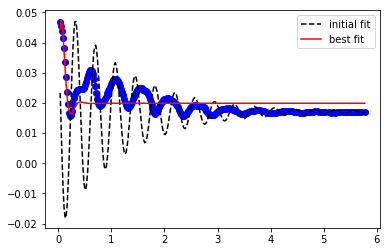

best popt= dict_values([0.06290621969885306, 11.463638220447448, 17.27956427291826, 0.019880418360719, 73.84261918002247])


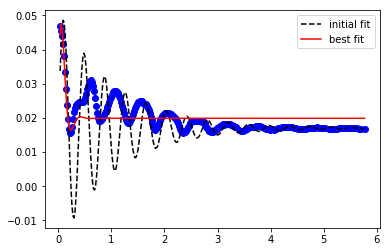

best popt= dict_values([0.06285731761948131, 11.456009036615288, 17.27519721738995, 0.0198804771206013, 54.993697083728385])


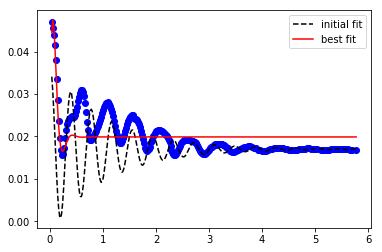

UnboundLocalError: local variable 'popt_min' referenced before assignment

In [156]:
def func(x, a, b, c, d, phi):
#     return a * np.exp(-b * x) + d
    return a * np.exp(-b * x)*np.cos(c*x + phi) + d

def Chebushev_mesh(x, K=0, N=1000):
    a, b = x[0], x[-1]
    x_new = np.linspace(a, b, N)
    A = (1 - K)/(b - a)
    B = K - 2*A*a
    C = a - A*a**2 - B*a
    x_new = A*x_new**2 + B*x_new + C
    return x_new

from numpy.random import rand
from scipy import interpolate, linspace
from scipy.interpolate import UnivariateSpline
from lmfit import Model

cases = ['20']
deltas = ['min']#, 'max'
list_x, list_y, list_colors, list_names, list_lines = [], [], [], [], []

def my_optimizer(x_src, y_src, func, iter=100, ):
    err_min = 1e+10
#     popt_min = 0.02, 0.8, 10, 0.017, 0 
#     tck = interpolate.splrep(x_src, y_src, s=0)
#     x = Chebushev_mesh(x_src, K=0., N=1001)
#     y = interpolate.splev(x, tck, der=0)
#     x = np.linspace(x_src[0], x_src[-1], 1001)
#     w = 1/(np.abs(x_src) + 1)
#     spl = UnivariateSpline(x_src, y_src, w=w, k=4)
#     y = spl(x)
    x, y = x_src, y_src 
    
    gmodel = Model(func)
#     plt.plot(x, y, 'r.')
#     plt.plot(x_src, y_src)
    for i in range(iter):
        try:
            a, b, c, d, phi = 0.05*rand() , 0.8*(1+0.2*rand()), 10*(1+rand()), 0.017, 100*rand()
            result = gmodel.fit(y, x=x, a=a, b=b, c=c, d=d, phi=phi)
            popt = result.best_values.values()
            print("best popt=", popt)
            
            plt.plot(x, y, 'bo')
            plt.plot(x, result.init_fit, 'k--', label='initial fit')
            plt.plot(x, result.best_fit, 'r-', label='best fit')
            plt.legend(loc='best')
            plt.show()
#             params = gmodel.make_params(a=a, b=b, c=c, d=d, phi=phi)
#             popt, pcov = curve_fit(func, x, y, p0=[a, b, c, d, phi])
#             y_fit = func(x, *popt)
            err = np.abs(y_fit - y).max()
            if err_min > err:
                err_min = err
                popt_min = popt
                print(err, err_min, popt, popt_min)
        except:
            pass
    nn = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f, phi=%5.3f' % tuple(popt_min)
#     nn = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f, phi=%5.3f' % tuple(popt_min)
    return x, func(x, *popt_min), nn

for i,delta_label in enumerate(deltas): 
    for j,case in enumerate(cases):
        print('case',case)
        tmin, tmax = 0., 6.5
        tt = tab[case]['t_ms']
        mask = (tt > tmin) & (tt < tmax)
        x = tab[case]['t_ms'][mask].values
        y = tab[case]['delta_' + delta_label][mask].values
        x_fit, y_fit, nn = my_optimizer(x, y, func, iter=5)
        
        list_x.append(x)
        list_y.append(y)
        list_x.append(x_fit)
        list_y.append(y_fit)
        list_colors.append(case_color[case])
        list_names.append(case_names[case])
        list_lines.append(case_line[delta_label])
        list_colors.append(case_color[case])
        list_names.append(case_names[case] + nn)
        list_lines.append(case_line[delta_label])

plot_graph(list_x, list_y, names=list_names, 
       xtitle='t, ms', ytitle='\u03b4<sub>*</sub>', image_name='delta_case_22_t_ms.pdf', \
       mode=mode_lines_and_markers_all, marker_size=2, line_size=1,\
       xrange=[0,6.5], yrange=[0.0,0.09],\
       dash=list_lines,\
       colors=list_colors,\
       width=1000, height=500, path=rpath, legend_orientation='h')
        
# xdata = np.linspace(0, 4, 100)
# y = func(xdata, 2.5, 1, 10, 1)
# np.random.seed(1729)
# y_noise = 0.2 * np.random.normal(size=xdata.size)
# ydata = y + y_noise
# popt, pcov = curve_fit(func, xdata, ydata)

# plt.plot(xdata, y, 'b-', label='exact')
# plt.plot(xdata, ydata, 'r-', label='data')
# plt.plot(xdata, func(xdata, *popt), 'g--',
#          label='fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt))
# plt.legend()

In [19]:
# def func(x, a, b, c, d, phi):
# #     return a * np.exp(-b * x) + d
#     return a * np.exp(-b * x)*np.cos(c*x + phi) + d
def func(x, A1, d1, omega, phi, delta, A2, d2):
    return A1 * np.exp(-d1 * x)*np.cos(omega*x + phi) + delta + A2*np.exp(-d2*x)

def Chebushev_mesh(x, K=0, N=1000):
    a, b = x[0], x[-1]
    x_new = np.linspace(a, b, N)
    A = (1 - K)/(b - a)
    B = K - 2*A*a
    C = a - A*a**2 - B*a
    x_new = A*x_new**2 + B*x_new + C
    return x_new

from numpy.random import rand
from scipy import interpolate, linspace
from scipy.interpolate import UnivariateSpline
from lmfit import Model

cases = ['20']
deltas = ['min']#, 'max'
list_x, list_y, list_colors, list_names, list_lines = [], [], [], [], []

def my_optimizer(x_src, y_src, func, iter=100, ):
    err_min = 1e+10
#     popt_min = 0.02, 0.8, 10, 0.017, 0 
#     tck = interpolate.splrep(x_src, y_src, s=0)
#     x = Chebushev_mesh(x_src, K=0., N=1001)
#     y = interpolate.splev(x, tck, der=0)
#     x = np.linspace(x_src[0], x_src[-1], 1001)
#     w = 1/(np.abs(x_src) + 1)
#     spl = UnivariateSpline(x_src, y_src, w=w, k=4)
#     y = spl(x)
    x, y = x_src, y_src 
    
    gmodel = Model(func)
#     plt.plot(x, y, 'r.')
#     plt.plot(x_src, y_src)
    for i in range(iter):
        try:
            result = gmodel.fit(y, x=x, A1=0.05*rand(), 
                                d1=0.8*(1+0.2*rand()), 
                                omega=10*(1+rand()), 
                                phi=100*rand(),
                                delta=0.017, 
                                A2=0.05*rand(),
                                d2 = 0.8*(1+0.2*rand())
                               )
            popt = result.best_values.values()
           
            
#             plt.plot(x, y, 'bo')
#             plt.plot(x, result.init_fit, 'k--', label='initial fit')
#             plt.plot(x, result.best_fit, 'r-', label='best fit')
#             plt.legend(loc='best')
#             plt.show()

#             popt, pcov = curve_fit(func, x, y, p0=[a, b, c, d, phi])
#             y_fit = func(x, *popt)
            err = np.abs(y_fit - y).max()
            if err_min > err:
                err_min = err
                popt_min = popt
                print("iter=", i, "best popt=", popt)
        except:
            pass
    nn = 'fit: A1=%5.3f, d1=%5.3f, omega=%5.3f, phi=%5.3f, delta=%5.3f, A2=%5.3f, d2=%5.3f' % tuple(popt_min)
#     nn = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f, phi=%5.3f' % tuple(popt_min)
    return x, func(x, *popt_min), nn

for i,delta_label in enumerate(deltas): 
    for j,case in enumerate(cases):
        print('case',case)
        tmin, tmax = 0., 6.5
        tt = tab[case]['t_ms']
        mask = (tt > tmin) & (tt < tmax)
        x = tab[case]['t_ms'][mask].values
        y = tab[case]['delta_' + delta_label][mask].values
        x_fit, y_fit, nn = my_optimizer(x, y, func, iter=500)
        
        list_x.append(x)
        list_y.append(y)
        list_x.append(x_fit)
        list_y.append(y_fit)
        list_colors.append(case_color[case])
        list_names.append(case_names[case])
        list_lines.append(case_line[delta_label])
        list_colors.append(case_color[case])
        list_names.append(case_names[case] + nn)
        list_lines.append(case_line[delta_label])

plot_graph(list_x, list_y, names=list_names, 
       xtitle='t, ms', ytitle='r"$\Large\hat{\delta}$"', image_name='delta_case_22_t_ms.pdf', \
       mode=mode_lines_and_markers_all, marker_size=2, line_size=1,\
       xrange=[0,6.5], yrange=[0.0,0.09],\
       dash=list_lines,\
       colors=list_colors,\
       width=1000, height=500, path=rpath, legend_orientation='h')
        
# xdata = np.linspace(0, 4, 100)
# y = func(xdata, 2.5, 1, 10, 1)
# np.random.seed(1729)
# y_noise = 0.2 * np.random.normal(size=xdata.size)
# ydata = y + y_noise
# popt, pcov = curve_fit(func, xdata, ydata)

# plt.plot(xdata, y, 'b-', label='exact')
# plt.plot(xdata, ydata, 'r-', label='data')
# plt.plot(xdata, func(xdata, *popt), 'g--',
#          label='fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt))
# plt.legend()

case 20


UnboundLocalError: local variable 'popt_min' referenced before assignment

In [742]:
plot_graph(list_x, list_y, names=list_names, 
       xtitle='t, ms', ytitle=r"$\Large\hat{\delta}$", image_name='delta_case_22_t_ms.pdf', \
       mode=mode_lines_and_markers_all, marker_size=2, line_size=1,\
       xrange=[0,6.5], yrange=[0.0,0.09],\
       dash=list_lines,\
       colors=list_colors,\
       width=1000, height=500, path=rpath, legend_orientation='h')

Successfully generated: /Users/weugene/basilisk/work/tube/delta_case_22_t_ms.pdf


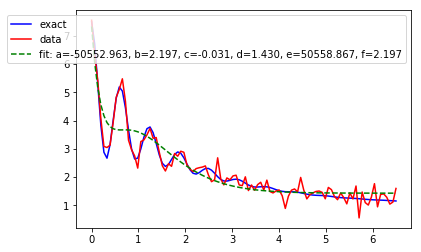

In [696]:
def func(x, a, b, c, d, e, f):
    return a * np.exp(-b * x)*np.cos(c*x) + d + e*np.exp(-f*x)

xdata = np.linspace(0, 6.5, 100)
y = func(xdata, 2.5, 1.1, 10, 1, 4, 0.5)
np.random.seed(17)
y_noise = 0.2 * np.random.normal(size=xdata.size)
ydata = y + y_noise
popt, pcov = curve_fit(func, xdata, ydata)

plt.plot(xdata, y, 'b-', label='exact')
plt.plot(xdata, ydata, 'r-', label='data')
plt.plot(xdata, func(xdata, *popt), 'g--',
         label='fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f, e=%5.3f, f=%5.3f' % tuple(popt))
plt.legend()